# imports

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
from PIL import Image
import glob
import json
from datetime import datetime

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
from torch.utils.data.dataset import Dataset  # For custom data-sets
import torchvision.transforms as transforms
import torchvision.utils as vutils

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [ ]:
print(torch.__version__)

1.7.0+cu101


In [ ]:
from platform import python_version

print(python_version())
# so we know what version to install in the conda environment on HPC

3.6.9


In [ ]:
torch.cuda.is_available()

True

In [ ]:
torch.cuda.current_device()
  # returns the current device ID

0

In [ ]:
torch.cuda.device_count()

1

In [ ]:
torch.cuda.get_device_name(0)

'Tesla P100-PCIE-16GB'

In [ ]:
!pwd

/content


In [ ]:
os.chdir("/content/drive/My Drive/Carlos_Research/GAN_nanop")
!pwd

/content/drive/My Drive/Carlos_Research/GAN_nanop


In [ ]:
!ls

best_G_progress_e1~100.mp4  loaded_GANS.ipynb  sym_nomse.mov
data.json		    nanop_data	       train_basic
dataloader.pt		    nanop_GAN.ipynb    train_BCELogit
dataloader_single.pt	    nanop_GAN.py       train_BCELogit_0.9
dataset.pt		    nonsym	       train_BCELogit_0.9_TTUR
dataset_single.pt	    nonsym_nomse.mov   training_images.png
HPC_models		    run_batch.s


## examples of saving dictionaries using `json`

In [ ]:
params = dict()
params["img_list"] = [1,2,3]
print(params["img_list"])

with open('data.json', 'w') as fp:
    json.dump(params, fp)
with open('data.json', 'r') as fp:
    datas = json.load(fp)
print(params)
print(datas)

[1, 2, 3]
{'img_list': [1, 2, 3]}
{'img_list': [1, 2, 3]}


## examples of identifing boolean values

In [ ]:
cont = bool(0)
if cont == 0:
  print("starting fresh trianing...")
else:
  print("continue training...")

cont = bool('0')
if cont == 0:
  print("starting fresh trianing...")
else:
  print("continue training...")

starting fresh trianing...
continue training...


# define inputs

Let’s define some inputs for the run:

* `dataroot` - the path to the root of the dataset folder. We will talk more about the dataset in the next section
* `workers` - the number of worker threads for loading the data with the DataLoader
* `batch_size` - the batch size used in training. The DCGAN paper uses a batch size of 128
* `image_size` - the spatial size of the images used for training. This implementation defaults to 64x64. If another size is desired, the structures of `D` and `G` must be changed. See [here](https://github.com/pytorch/examples/issues/70) for more details
* `nc` - number of color channels in the input images. For color images this is 3
* `nz` - length of latent vector
* `ngf` - relates to the depth of feature maps carried through the generator
* `ndf` - sets the depth of feature maps propagated through the discriminator
* `num_epochs` - number of training epochs to run. Training for longer will probably lead to better results but will also take much longer
* `lr` - learning rate for training. As described in the DCGAN paper, this number should be 0.0002
* `beta1` - beta1 hyperparameter for Adam optimizers. As described in paper, this number should be 0.5
* `ngpu` - number of GPUs available. If this is 0, code will run in CPU mode. If this number is greater than 0 it will run on that number of GPUs

In [ ]:
# Root directory for dataset
dataroot = "nanop_data"

# Number of workers for dataloader
workers = 2

# Batch size during training
# batch_size = 25
batch_size = 64

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 512

# Number of channels in the training images. For color images this is 3, for our grayscale image is 1
nc = 1

# Size/length of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator, i.e. # of channels of the kernel
ngf = 64

# Size of feature maps in discriminator, i.e. # of channels of the kernel
ndf = 64

# Number of training epochs
num_epochs = 5

# Learning rate for optimizers
lr = 0.0001

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [ ]:
# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

print(device)

cuda:0


# load data


Once downloaded, create a directory named `nanop_data` and extract the zip file into that directory, so all your actual images will be in a **sub-directory** inside the `nanop_data` directory. Then, set the dataroot input for this notebook to the `nanop_data` directory you just created. 

This is an important step because we will be using the ImageFolder dataset class, which requires there to be **subdirectories** in the dataset folder, which is our `celeba` folder. Now, we can create the dataset, create the dataloader, set the device to run on, and finally visualize some of the training data.

In [ ]:
print(dataroot)
print(image_size)
print(batch_size)
print(workers)

nanop_data
512
64
2


## load 1 image

<class 'PIL.TiffImagePlugin.TiffImageFile'>


/usr/local/lib/python3.6/dist-packages/torchvision/transforms/functional.py:92: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  img = torch.from_numpy(np.array(pic, np.float32, copy=False))


torch.Size([1, 876, 927])


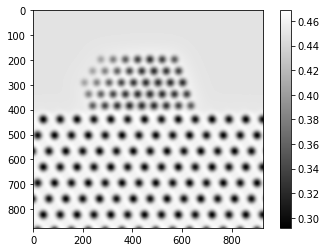

In [ ]:
# from https://discuss.pytorch.org/t/training-a-cnn-with-tiff-images-in-pytorch/9531
image1 = Image.open(dataroot+'/1/PtNp1-D0_ceria1-D0_[-110]_30A_00x00y00z_180slc_1024x1024_0nmDefocus.tif')
print(type(image1))
  # so Image.open() returns a PIL image
image1 = transforms.ToTensor()(image1)
print(image1.shape)
plt.imshow(image1[0], cmap='gray');
plt.colorbar();

In [ ]:
# why does the image not resemble what is shown on my computer?
print(image1[0].mean())
print(image1[0].max())
print(image1[0].min())

tensor(0.4377)
tensor(0.4687)
tensor(0.2919)


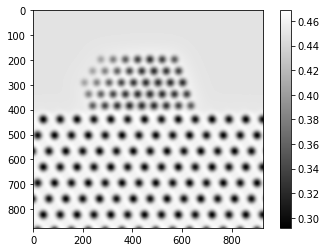

In [ ]:
plt.imshow(image1[0], cmap='gray' , vmin=image1[0].min(), vmax=image1[0].max())
# so when you don't specify vmin and vmax imshow auto used the min and max values of the tensor
plt.colorbar()

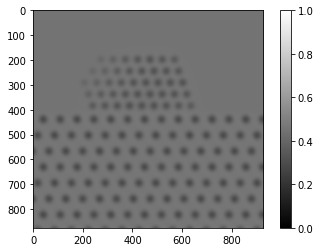

In [ ]:
plt.imshow(image1[0], cmap='gray' , vmin=0, vmax=1)
# this resembles the image displayed from the computer end
plt.colorbar()
# so our original images take range [0, 1]

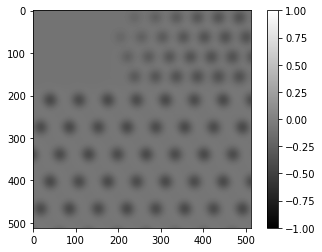

In [ ]:
image11 = Image.open(dataroot+'/1/PtNp1-D0_ceria1-D0_[-110]_30A_00x00y00z_180slc_1024x1024_0nmDefocus.tif')
transforms_p = transforms.Compose([
                                transforms.RandomCrop((512,512)), # rescale size to 512 by 512 by interpolation
                                  # should not resize microscope images, this distorts the atoms
                                transforms.ToTensor(),
                                transforms.Normalize(0.5, 0.5) # normalize to mean=0.5 and std=0.5
                                  # this converts all values form 0~1 to -1~1 so scale you vmin and vmax accordingly
                                  # https://discuss.pytorch.org/t/how-should-i-convert-tensor-image-range-1-1-to-0-1/26792
                      ])
patch = transforms_p(image11)
plt.imshow(patch[0], cmap='gray', vmin=-1, vmax=1)
plt.colorbar()

tensor(-0.1246)
tensor(-0.0626)
tensor(-0.4161)


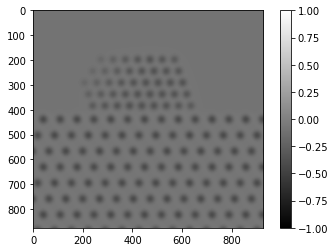

In [ ]:
image_norm = transforms.Normalize(0.5, 0.5)(image1)
print(image_norm[0].mean())
print(image_norm[0].max())
print(image_norm[0].min())
plt.imshow(image_norm[0], cmap='gray', vmin=-1, vmax=1)
  # so we can confirm that, after normalization, we indeed changed the range to [-1, 1]
plt.colorbar()

tensor(0.4377)
tensor(0.4687)
tensor(0.2919)


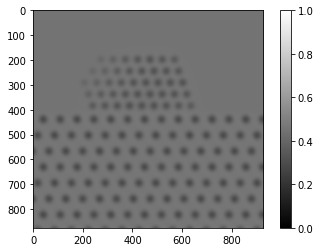

In [ ]:
image_back = transforms.Normalize(-1, 2)(image_norm)
print(image_back[0].mean())
print(image_back[0].max())
print(image_back[0].min())
plt.imshow(image_back[0], cmap='gray', vmin=0, vmax=1)
  # so we can confirm that we can use mean=-1 and std=2 to re-scale image back in range [0, 1]
plt.colorbar()

tensor(0.4377)
tensor(0.4687)
tensor(0.2919)


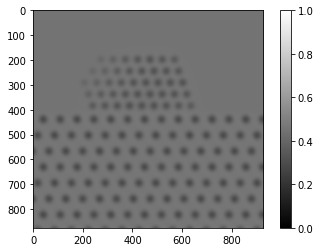

In [ ]:
image_back2 = image_norm*0.5+0.5
print(image_back2[0].mean())
print(image_back2[0].max())
print(image_back2[0].min())
plt.imshow(image_back2[0], cmap='gray', vmin=0, vmax=1)
  # so we can confirm that we can also use inverse operations to re-scale image back in range [0, 1]
plt.colorbar()

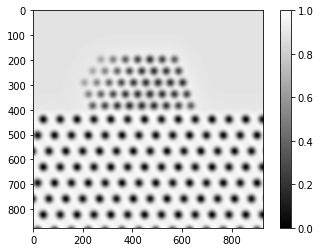

In [ ]:
plt.imshow(vutils.make_grid(image1, nrow=1, padding=5, normalize=True)[0], cmap='gray', vmin=0, vmax=1)
  # this would look the same as the un-normalized plotted on [min, max] just with the colors shifted to be between [0, 1]
  # compared to the plot of the un-normalized that were ploted between [0, 1] instead of [min, max]
  # this exagerrates the contrast by making the min and max of the tensor the extremes of their range
plt.colorbar()

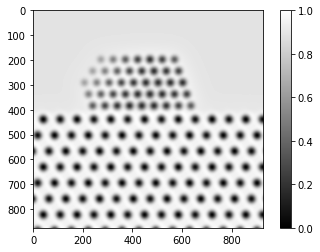

In [ ]:
image_norm2 = (image1 - image1.min())/(image1.max()-image1.min())
  # this is what the normalized option in make_grid performed
plt.imshow(image_norm2[0], cmap='gray', vmin=0, vmax=1)
plt.colorbar()

## load all images

In [ ]:
# from https://stackoverflow.com/questions/53530751/how-make-customised-dataset-in-pytorch-for-images-and-their-masks

# get all the image and mask path and number of images

# folder_data = glob.glob(dataroot+'/1/*.tif')
folder_data=[]
  # this is a list of all the file path that ends with .tif

for i in range(1,2):
  print("addding image foler {}".format(i))
  folder_data.extend(glob.glob(dataroot+'/'+str(i)+'/*.tif'))
  # add all image file-paths from different image folders to the list of image file paths


print(type(folder_data))

#  folder_mask = glob.glob("D:\\Neda\\Pytorch\\U-net\\BMMCmasks\\masks\\*.tif")

# split these path using a certain percentage
len_data = len(folder_data)
print(len_data)
#  train_size = 0.6

#  train_image_paths = folder_data[:int(len_data*train_size)]
#  test_image_paths = folder_data[int(len_data*train_size):]

#  train_mask_paths = folder_mask[:int(len_data*train_size)]
#  test_mask_paths = folder_mask[int(len_data*train_size):]




addding image foler 1
<class 'list'>
1000


In [ ]:
class CustomDataset_resize(Dataset):
  def __init__(self, image_paths, train=True):   # initial logic happens like transform
    self.image_paths = image_paths
      # image_paths is a list where each element is a file path to 1 image
    
    # self.target_paths = target_paths
    self.transforms = transforms.Compose([
                                          transforms.Resize((512,512)), # rescale size to 512 by 512 by interpolation
                                            # should not resize microscope images, this distorts the atoms
                                          transforms.ToTensor(),
                                          transforms.Normalize(0.5, 0.5) # normalize to mean=0.5 and std=0.5
                                            # this converts all values form 0~1 to -1~1 so scale you vmin and vmax accordingly
                                            # https://discuss.pytorch.org/t/how-should-i-convert-tensor-image-range-1-1-to-0-1/26792
                      ])

  def __getitem__(self, index):
    image = Image.open(self.image_paths[index])
    # mask = Image.open(self.target_paths[index])
    t_image = self.transforms(image)
    return t_image, 0
      # since we don't have a corresponding `y` here for each sample image, just fill in 0 for `y`

  def __len__(self):  # return count of sample we have
    return len(self.image_paths)


class CustomDataset_crop(Dataset):
  def __init__(self, image_paths, train=True):   # initial logic happens like transform
    self.image_paths = image_paths
      # image_paths is a list where each element is a file path to 1 image
    # self.target_paths = target_paths
    self.transforms = transforms.Compose([
                                          # transforms.CenterCrop(512),
                                          transforms.RandomCrop(512),
                                            # randomly crops a 512x512 image from the input image
                                          transforms.ToTensor(),
                                          transforms.Normalize(0.5, 0.5) # normalize to mean=0.5 and std=0.5
                                            # this converts all values form 0~1 to -1~1 so scale you vmin and vmax accordingly
                                            # https://discuss.pytorch.org/t/how-should-i-convert-tensor-image-range-1-1-to-0-1/26792
                      ])

  def __getitem__(self, index):
    image = Image.open(self.image_paths[index])
    # mask = Image.open(self.target_paths[index])

    # seed = np.random.randint(2147483647) # make a seed with numpy generator 
    # random.seed(999) # apply this seed to img transforms

    t_image = self.transforms(image)
    # print(self.image_paths[index])
    return t_image, 0
      # since we don't have a corresponding `y` here for each sample image, just fill in 0 for `y`

  def __len__(self):  # return count of sample we have
    return len(self.image_paths)


In [ ]:
dataset = CustomDataset_crop(folder_data)

In [ ]:
# save dataset object
torch.save(dataset, "dataset.pt")

We can't use `ImageFolder` here because our images are in `.tif` format which is not yet supported
```python
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                              #  transforms.Resize((512,512)), # convert size to 512 by 512
                               transforms.ToTensor(), # transform from image to tensor
                              #  transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)), 
                                  # normalize to mean=0.5 and std=0.5 for all 3 channels
                           ]))
```

In [ ]:
print(type(dataset))

__main__.CustomDataset_crop


In [ ]:
print(batch_size)

64


In [ ]:
# Create the dataloader
# dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
#                                          shuffle=False, num_workers=workers)

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)
torch.save(dataloader, "dataloader.pt")
print(type(dataloader))

torch.utils.data.dataloader.DataLoader


### plot some training images

In [ ]:
# real_batch = next(iter(dataloader2));
real_batch = next(iter(dataloader));
# get 1 batch of samples, which is 64 samples per our defined batch_size


In [ ]:
print(type(real_batch))
  # it is a list grabed from the dataset
print(len(real_batch))
  # it has 2 element, which is each a list by themsevles
print(len(real_batch[0]))
  # the first list contains all 64 samples, where each sample is a image in tensor form
print(len(real_batch[1]))
  # the second list contains all 64 labels, where each label is the integer 0 from defining our dataset
print(real_batch[1])
print(real_batch[0][0].shape)
print(np.transpose(real_batch[0][0]).shape)
  # make it channels last because that is the format that plt.imshow takes
  # but this also flips the row and column of the image
  # so we have to specify how to transpose the image
print(np.transpose(real_batch[0][0], (1, 2, 0)).shape)
  # this puts the 2nd dimension first, the 3rd dimension second, and the first dimension last
  # this way, the relative row and column order is preserved

<class 'list'>
2
64
64
tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])
torch.Size([1, 512, 512])
torch.Size([512, 512, 1])
torch.Size([512, 512, 1])


In [ ]:
print("shape when we grab the first 16 images from out batch:",(real_batch[0].to(device)[:16]).shape)
print("shape of 1 image in our batch:",(real_batch[0].to(device)[0]).shape)
print("shape when we grab the first 16 images from out batch with np.squeeze():", 
      np.squeeze(real_batch[0].to(device)[:16]).shape)
print("type of grabing the first 16 images:",type([np.squeeze(real_batch[0].to(device)[i]) for i in range(16)]))
print("length of grabing the first 16 images:",len([np.squeeze(real_batch[0].to(device)[i]) for i in range(16)]))
print("shape of the first image in the 16 images grabbed with np.squeeze():",
      ([np.squeeze(real_batch[0].to(device)[i]) for i in range(16)][0]).shape)

shape when we grab the first 16 images from out batch: torch.Size([16, 1, 512, 512])
shape of 1 image in our batch: torch.Size([1, 512, 512])
shape when we grab the first 16 images from out batch with np.squeeze(): torch.Size([16, 512, 512])
type of grabing the first 16 images: <class 'list'>
length of grabing the first 16 images: 16
shape of the first image in the 16 images grabbed with np.squeeze(): torch.Size([512, 512])


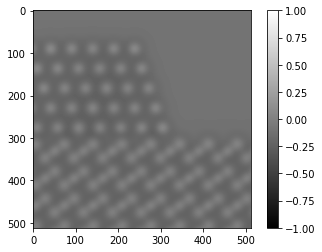

In [ ]:
plt.imshow(real_batch[0][0][0], cmap='gray', vmin=-1, vmax=1) 
  # since the first dimenion is the channel, we don't need it for grayscale
  # since when the data is loaded it is rescaled to -1~1, we have to set the scale here to -1~1
plt.colorbar()

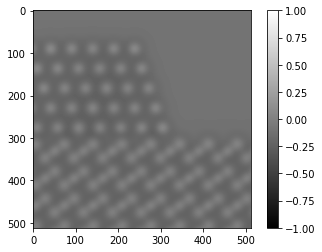

In [ ]:
plt.imshow(np.squeeze(real_batch[0][0]), cmap='gray', vmin=-1, vmax=1) 
plt.colorbar()

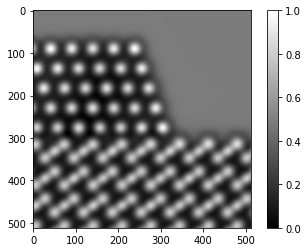

In [ ]:
plt.imshow(vutils.make_grid(real_batch[0][0][0], nrow=1, padding=5, normalize=True)[0], cmap='gray', vmin=0, vmax=1)
  # as shown before, this exaggerates the contrast in images! by making the min and max of the tensor the extremes of their range
  # but this is not what the image looks like from the computer end
plt.colorbar()

In [ ]:
print(real_batch[0][0].mean())
print(real_batch[0][0].max())
print(real_batch[0][0].min())

tensor(-0.1307)
tensor(0.0589)
tensor(-0.2494)


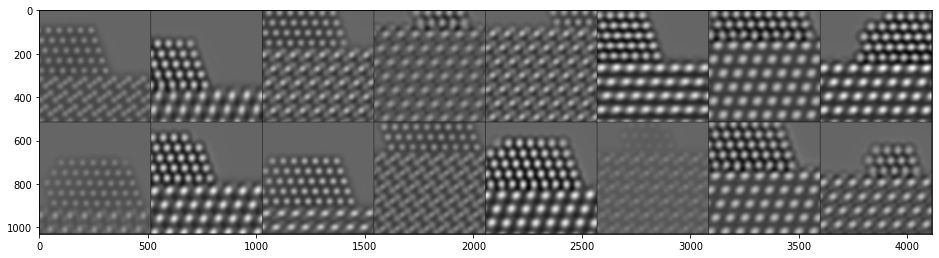

In [ ]:
plt.figure(figsize=(16,8))
plt.imshow((vutils.make_grid(real_batch[0][:16], padding=2, normalize=True))[0], cmap='gray', vmin=0, vmax=1)

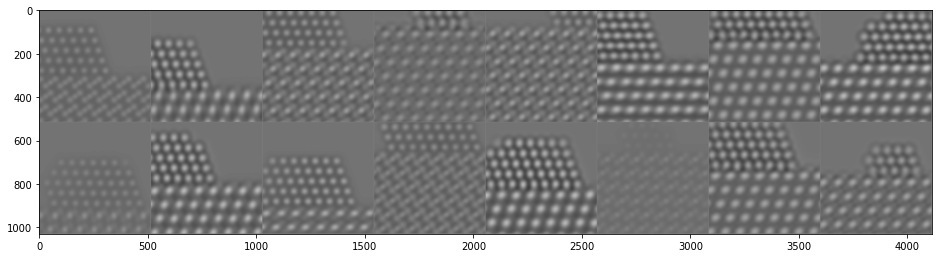

In [ ]:
plt.figure(figsize=(16,8))
plt.imshow((vutils.make_grid(real_batch[0][:16], padding=2, normalize=False))[0], cmap='gray', vmin=-1, vmax=1)

torch.Size([3, 2058, 2058])
True
True


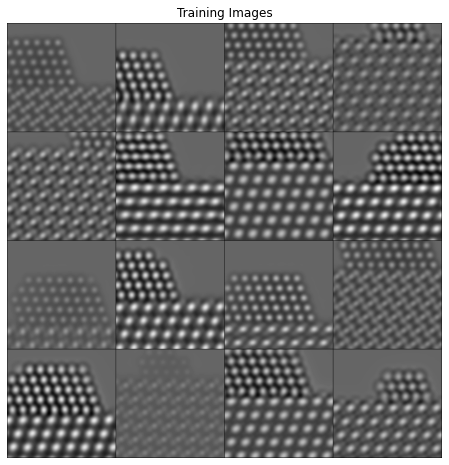

In [ ]:
# Plot some training images
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
grid = vutils.make_grid((real_batch[0].to(device)[:16]), 
                        # [(real_batch[0].to(device)[i]) for i in range(16)], 
                        padding=2,
                        nrow=4, 
                        normalize=True).cpu()
print(grid.shape)
  # because vutils assumes input are RGB images, not 2D greyscale (or 3D with only 1 channel)
  # it will output a quilt of the images also with 3 channels
  # so if your input images only has 1 channel (greyscale), it will just output a quilt where all 3 channels are equal
  # any one of those three channels can represent the greyscale image
print(torch.equal(grid[0],grid[1]))
print(torch.equal(grid[0],grid[2]))
plt.imshow(grid[1], cmap='gray', vmin=0, vmax=1)
  # since our grid normalized all images, scale is from 0~1
plt.savefig("training_images")

## **DO NOT RUN** - load saved dataset or dataloader 

just look at the results.

All below were tested using `CenterCrop` instead to check whether the loaded objects are valid. And `torch.Dataloader` with `shuffle=False`.

In [ ]:
dataset2 = torch.load("dataset.pt")
print(type(dataset2))

print("size of original dataset: ",len(dataset))
print("size of loaded dataset: ",len(dataset2))
print(torch.equal(dataset[0][0], dataset2[0][0]))
  # grab the first sample and its tensor component of the tuple

__main__.CustomDataset_crop
size of original dataset:  1000
size of loaded dataset:  1000
True


In [ ]:
dataloader2 = torch.utils.data.DataLoader(dataset2, batch_size=batch_size,
                                         shuffle=False, num_workers=workers)

dataloader3 = torch.load("dataloader.pt")

print(dataloader2 == dataloader)
print(dataloader3 == dataloader)
print(dataloader2 == dataloader3)

False
False
False


In [ ]:
# ok but then why are all the dataloaders different?
print("size of original dataloader: ",len(dataloader))
print("size of loaded dataloader: ",len(dataloader2))
print("size of loaded dataloader: ",len(dataloader3))

# they do have the same length, from 1000/64
# and we know that within each batch, the images are all the same because they are all centercrop
# could it be that the images were shuffled?
# go back and change the shuffle to False for the original dataloader and try again
# no it still shows false, let's try the dataset with only 1 sample

size of original dataloader:  16
size of loaded dataloader:  16
size of loaded dataloader:  16


In [ ]:
b1 = next(iter(dataloader))
b2 = next(iter(dataloader2))
b3 = next(iter(dataloader3))

In [ ]:
print(b1[0][0])
print(b2[0][0])
print(b3[0][0])

tensor([[[-0.1000, -0.1000, -0.0999,  ..., -0.1002, -0.1002, -0.1002],
         [-0.1000, -0.1000, -0.0999,  ..., -0.1001, -0.1002, -0.1002],
         [-0.1000, -0.0999, -0.0999,  ..., -0.1001, -0.1001, -0.1002],
         ...,
         [-0.0436, -0.0395, -0.0362,  ..., -0.1302, -0.1352, -0.1401],
         [-0.0289, -0.0247, -0.0216,  ..., -0.1344, -0.1390, -0.1437],
         [-0.0143, -0.0102, -0.0074,  ..., -0.1387, -0.1429, -0.1472]]])
tensor([[[-0.1000, -0.1000, -0.0999,  ..., -0.1002, -0.1002, -0.1002],
         [-0.1000, -0.1000, -0.0999,  ..., -0.1001, -0.1002, -0.1002],
         [-0.1000, -0.0999, -0.0999,  ..., -0.1001, -0.1001, -0.1002],
         ...,
         [-0.0436, -0.0395, -0.0362,  ..., -0.1302, -0.1352, -0.1401],
         [-0.0289, -0.0247, -0.0216,  ..., -0.1344, -0.1390, -0.1437],
         [-0.0143, -0.0102, -0.0074,  ..., -0.1387, -0.1429, -0.1472]]])
tensor([[[-0.1000, -0.1000, -0.0999,  ..., -0.1002, -0.1002, -0.1002],
         [-0.1000, -0.1000, -0.0999,  ..., -0

In [ ]:
# they actually do store the same data! despite the fact that they are not equal to each other
# this proves that the equation was just comparing memory address
# what if we go back to using RandomCrop? 
# surely, dataloader2 would be different because dataset2 would be different
# but what about dataloader3? Will it saved the cropped images as is?

# nope, if we don't use CenterCrop, all dataloaders will be different
# so no matter if we save the dataset or the dataloader, when we load the saved objects
# the __getitem__ gets called again and returns different patches
# I mean this wouldn't matter to us, we just using random patches anyway
# so as long as they are valid patches, it is just as useful to us
# it is just that we have testified that using RandomCrop instead of CenterCrop
# our loaded object will never be the exact same as the original object

In [ ]:
# so the first tensor of the two datasets are not the same
# maybe the dataset is the same, it is just that the samples are out of order
# let's try a dataset with only 1 sample

folder_data2 = ["/content/drive/MyDrive/Carlos_Research/GAN_nanop/nanop_data/1/PtNp1-D0_ceria1-D0_[-110]_30A_00x00y00z_180slc_1024x1024_0nmDefocus.tif"]
dataset_single = CustomDataset_crop(folder_data2)
torch.save(dataset_single, "dataset_single.pt")

In [ ]:
dataset_single2 = torch.load("dataset_single.pt")

In [ ]:
print("size of original dataset: ",len(dataset_single))
print("size of loaded dataset: ",len(dataset_single2))
print(torch.equal(dataset_single[0][0], dataset_single2[0][0]))

size of original dataset:  1
size of loaded dataset:  1
True


In [ ]:
print(dataset_single)
print(dataset_single2)

In [ ]:
print(dataset_single[0][0])
print(dataset_single2[0][0])

tensor([[[-0.0988, -0.0987, -0.0987,  ..., -0.1002, -0.1002, -0.1002],
         [-0.0987, -0.0987, -0.0986,  ..., -0.1002, -0.1002, -0.1002],
         [-0.0987, -0.0986, -0.0986,  ..., -0.1002, -0.1002, -0.1002],
         ...,
         [-0.2459, -0.2635, -0.2810,  ..., -0.1237, -0.1143, -0.1061],
         [-0.2487, -0.2666, -0.2845,  ..., -0.1255, -0.1159, -0.1074],
         [-0.2502, -0.2684, -0.2864,  ..., -0.1269, -0.1170, -0.1084]]])
tensor([[[-0.0988, -0.0987, -0.0987,  ..., -0.1002, -0.1002, -0.1002],
         [-0.0987, -0.0987, -0.0986,  ..., -0.1002, -0.1002, -0.1002],
         [-0.0987, -0.0986, -0.0986,  ..., -0.1002, -0.1002, -0.1002],
         ...,
         [-0.2459, -0.2635, -0.2810,  ..., -0.1237, -0.1143, -0.1061],
         [-0.2487, -0.2666, -0.2845,  ..., -0.1255, -0.1159, -0.1074],
         [-0.2502, -0.2684, -0.2864,  ..., -0.1269, -0.1170, -0.1084]]])


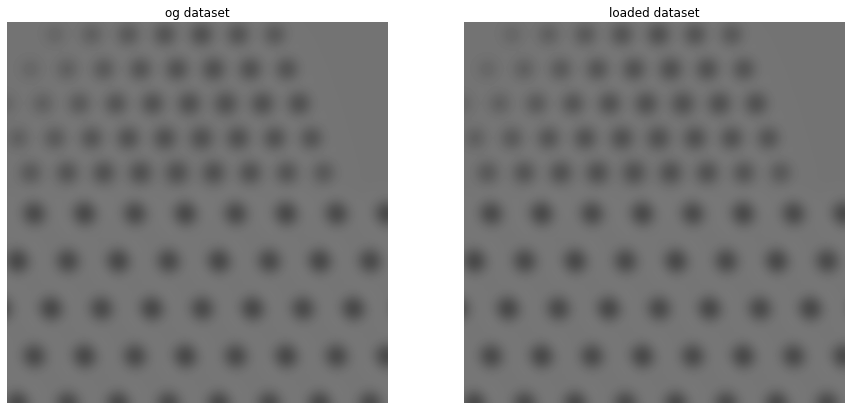

In [ ]:
# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
  # add 1 row and 2 columns of subplots, this will be the first of them
plt.axis("off")
plt.title("og dataset")
plt.imshow(dataset_single[0][0][0], cmap='gray', vmin=-1, vmax=1)

plt.subplot(1,2,2)
  # add 1 row and 2 columns of subplots, this will be the second of them
plt.axis("off")
plt.title("loaded dataset")
plt.imshow(dataset_single2[0][0][0], cmap='gray', vmin=-1, vmax=1)
plt.show()

In [ ]:
# ok, so the images are definitely different. 
# but they look like different patches of the SAME image
# when we did RandomCrop, even with the same seed, do we not get the same patch?
# it looks like we have to make a numpy random seed WITHIN the dataset class
# it is not enough to just set it globally?
# https://stackoverflow.com/questions/59516181/fix-random-seed-for-torchvision-transforms
# after trying the above, we still get different patches


In [ ]:
# let's try CenterCrop then since that is fixed
# CenterCrop worked! So when a dataset is loaded, somehow the dataset __getitem__ method is called again 
# and lead to a different patch?

# in fact, after using CenterCrop, the entire dataset of 1000 samples are the same when loaded vs original

In [ ]:
dataloader_single = torch.utils.data.DataLoader(dataset_single, batch_size=batch_size,
                                                shuffle=False, num_workers=workers)
torch.save(dataloader_single, "dataloader_single.pt")

In [ ]:
dataloader_single2 = torch.utils.data.DataLoader(dataset_single2, batch_size=batch_size,
                                                shuffle=False, num_workers=workers)

dataloader_single3 = torch.load("dataloader_single.pt")

In [ ]:
print(dataloader_single2 == dataloader_single)
print(dataloader_single3 == dataloader_single)
print(dataloader_single2 == dataloader_single3)

False
False
False


In [ ]:
b1 = next(iter(dataloader_single))
b2 = next(iter(dataloader_single2))
b3 = next(iter(dataloader_single3))

In [ ]:
print(b1[0])
print(b2[0])
print(b3[0])

tensor([[[[-0.0988, -0.0987, -0.0987,  ..., -0.1002, -0.1002, -0.1002],
          [-0.0987, -0.0987, -0.0986,  ..., -0.1002, -0.1002, -0.1002],
          [-0.0987, -0.0986, -0.0986,  ..., -0.1002, -0.1002, -0.1002],
          ...,
          [-0.2459, -0.2635, -0.2810,  ..., -0.1237, -0.1143, -0.1061],
          [-0.2487, -0.2666, -0.2845,  ..., -0.1255, -0.1159, -0.1074],
          [-0.2502, -0.2684, -0.2864,  ..., -0.1269, -0.1170, -0.1084]]]])
tensor([[[[-0.0988, -0.0987, -0.0987,  ..., -0.1002, -0.1002, -0.1002],
          [-0.0987, -0.0987, -0.0986,  ..., -0.1002, -0.1002, -0.1002],
          [-0.0987, -0.0986, -0.0986,  ..., -0.1002, -0.1002, -0.1002],
          ...,
          [-0.2459, -0.2635, -0.2810,  ..., -0.1237, -0.1143, -0.1061],
          [-0.2487, -0.2666, -0.2845,  ..., -0.1255, -0.1159, -0.1074],
          [-0.2502, -0.2684, -0.2864,  ..., -0.1269, -0.1170, -0.1084]]]])
tensor([[[[-0.0988, -0.0987, -0.0987,  ..., -0.1002, -0.1002, -0.1002],
          [-0.0987, -0.0987,

In [ ]:
# well, it shows that actually they do store the same data
# but the dataloader objects are not equal to each other
# this is probably because they are objects, and when they are compared, it compares their memory addresses
# and obviously their memory addresses are going to be different
# let's go back to the 1000 big dataloader and see if they contain the same data

In [ ]:
#------------------------------------------------------------------------------------------------------------

# so the conclusion is that saving either dataset or the dataloader can give you back your images
# it's just that with RandomCrop, you will get different patches from loading them
# so i guess save the dataloader since it is a known torch object

In [ ]:
!ls

a.pt	      D_loss2.txt	img_list.ts	      nanop_GAN.py
best_G.md     D_loss.txt	model_checkpoints     nonsym_nomse.mov
best_img.png  GD_loss_plot.png	nanop_data	      result_figs
dataset_0.pt  G_loss2.txt	nanop_dataloader.pth  run_batch.s
dataset.pt    G_loss.txt	nanop_GAN	      sym_nomse.mov


# weight initialization

all model weights shall be randomly initialized from a Normal distribution with `mean=0`, `stdev=0.02`. The `weights_init` function takes an initialized model as input and reinitializes all convolutional, convolutional-transpose, and batch normalization layers to meet this criteria. This function is applied to the models immediately after initialization.



In [ ]:
# custom weights initialization called on netG and netD
def weights_init(m):
    # m will be a model module that inherits the nn.Module class, so it will have the following attributes
    classname = m.__class__.__name__
    if classname.find('Conv') != -1: 
        # if the class name contains the partial string 'Conv'
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        # if the class name contains the partial string 'BatchNorm'
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
"string".find("as")

-1

In [ ]:
"string".find("rin")

2

# Generator

The generator, `G`, is designed to map the latent space vector (`z`) to data-space. Since our data are images, converting `z` to data-space means ultimately creating a RGB image with the same size as the training images (i.e. 3x64x64). 

In practice, this is accomplished through a series of strided two dimensional **convolutional transpose layers**, each paired with a 2-d batch norm layer and a ReLu activation. 

The output of the generator is fed through a `tanh` function to return it to the input data range of `[−1,1]`.

It is worth noting the existence of the **batch norm functions after the conv-transpose** layers, as this is a critical contribution of the DCGAN paper. These layers help with the flow of gradients during training. An image of the generator from the DCGAN paper is shown below.

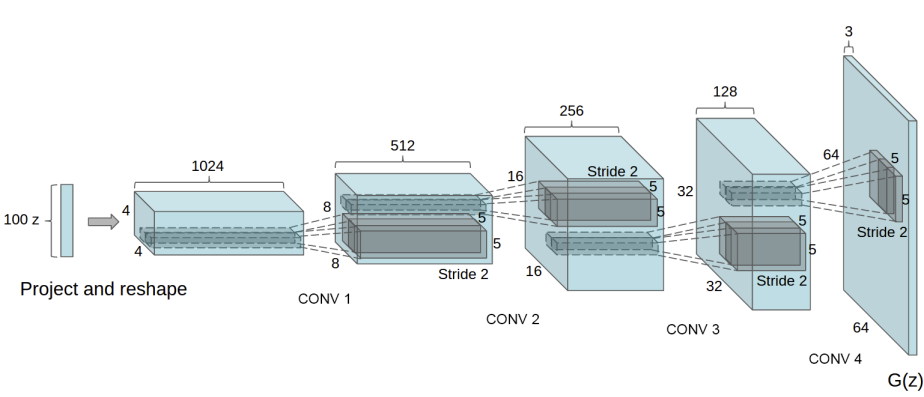

Notice, the how the inputs we set in the input section ($n_z$, $n_{gf}$, and $n_c$) influence the generator architecture in code. 
* $n_z$ is the length of the $z$ input vector
* $n_{gf}$ relates to the size of the feature maps that are propagated through the generator
* $n_c$ is the number of channels in the output image (set to 3 for RGB images). 

Below is the code for the generator.

In [ ]:
nc=1
print(nz)
print(ngf)
print(nc)
print(int(ngf/2))
print(int(ngf/4))

100
64
1
32
16


In [ ]:
# Generator Archi ---------------------------------------------------------------------------------------------------------------------------
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is latent vector Z of shape (nz x 1 x 1), going into a convolution
            nn.ConvTranspose2d(nz, ngf * 16, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),
              # state size. (ngf*16) x 4 x 4, where 4 = n+k-1= 1+4-1
              # to figure out the dimension of convtrans, just ask what dimension with the current setting gets you the current dimension
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
              # state size. (ngf*8) x 8 x 8, where 8 = (n-1)*s+k-2p = 3*2+4-2
            nn.ConvTranspose2d( ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
              # state size. (ngf*4) x 16 x 16, where 16 = (n-1)*s+k-2p = 7*2+4-2
            nn.ConvTranspose2d( ngf * 4, ngf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*2),
            nn.ReLU(True),
              # state size. (ngf*2) x 32 x 32, where 32 = (n-1)*s+k-2p = 15*2+4-2
            nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
              # state size. (ngf) x 64 x 64, where 64 = (n-1)*s+k-2p = 31*2+4-2
            nn.ConvTranspose2d(ngf, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
              # state size. (ngf) x 128 x 128, where 128 = (n-1)*s+k-2p = 63*2+4-2
            nn.ConvTranspose2d(ngf, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
              # state size. (ngf) x 256 x 256, where 256 = (n-1)*s+k-2p = 127*2+4-2
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
              # state size. (nc) x 512 x 512, where 512 = (n-1)*s+k-2p = 255*2+4-2
            nn.Tanh()
            
        )

    def forward(self, input):
        return self.main(input)

Now, we can instantiate the generator and apply the `weights_init` function. Check out the printed model to see how the generator object is structured.

In [ ]:
# Create the generator
netG = Generator(ngpu).to(device)
  # moves the model to the GPU

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
      # Implements data parallelism at the module level.

# Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model structure
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchN

# Discriminator

As mentioned, the discriminator, `D`, is a binary classification network that takes an image as input and outputs a scalar probability that the input image is real (as opposed to fake). So if `D` outputs 0.8 for a particular generated image, it means that `D` things the image has an 80% probability of being real.

Here, `D` takes a 1x512x512 input image, processes it through a series of `Conv2d`, `BatchNorm2d`, and `LeakyReLU` layers, and outputs the final probability of the image being real through a `Sigmoid` activation function. 

This architecture can be extended with more layers if necessary for the problem, but there is significance to the use of the strided convolution, BatchNorm, and LeakyReLUs. 

The DCGAN paper mentions it is a good practice to use strided convolution rather than pooling to downsample because it lets the network learn its own pooling function. *(Instead of your specified max-pool)*. Also batch norm and leaky relu functions promote healthy gradient flow which is critical for the learning process of both `G` and `D`.

In [ ]:
print(ndf)
  # depth of feature maps propagated through the discriminator
print(nc)

64
1


In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is an real or generated image of shape (nc) x 512 x 512
            nn.Conv2d(nc, ndf, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf) x 256 x 256, where 256 = (n+2p-k)/s+1 = (512+2-4)/2+1 
            nn.Conv2d(ndf, ndf , 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf) x 128 x 128, where 128 = (n+2p-k)/s+1 = (256+2-4)/2+1 
            nn.Conv2d(ndf, ndf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf) x 64 x 64, where 64 = (n+2p-k)/s+1 = (128+2-4)/2+1 
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*2) x 32 x 32, where 32 = (n+2p-k)/s+1 = (64+2-4)/2+1
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*4) x 16 x 16, where 16 = (n+2p-k)/s+1 = (32+2-4)/2+1
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*8) x 8 x 8, where 8 = (n+2p-k)/s+1 = (16+2-4)/2+1  
            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*16) x 4 x 4, where 4 = (n+2p-k)/s+1 = (8+2-4)/2+1  
            nn.Conv2d(ndf * 16, 1, kernel_size=4, stride=1, padding=0, bias=False),
              # state size. 1 x 1 x 1, where 1 = (n+2p-k)/s+1 = (4+0-4)/1+1 
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# does the channels need to be symmetric for D and G? Like in the example?
# yes, symmetric performed much better, it makes sure one does not out-power the other

Now, as with the generator, we can create the discriminator, apply the `weights_init` function, and print the model’s structure.

In [ ]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(64, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(256, eps=1e-05, moment

old discriminator that was not symmetric with `G`
```python
class Discriminator_nonsym(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is an real or generated image of shape (1) x 512 x 512
            nn.Conv2d(nc, ndf, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf) x 256 x 256, where 256 = (n+2p-k)/s+1 = (512+2-4)/2+1 
            nn.Conv2d(ndf, ndf*2 , 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*2),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*2) x 128 x 128, where 128 = (n+2p-k)/s+1 = (256+2-4)/2+1 
            nn.Conv2d(ndf*2, ndf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*4),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*4) x 64 x 64, where 64 = (n+2p-k)/s+1 = (128+2-4)/2+1 
            nn.Conv2d(ndf*4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*8) x 32 x 32, where 32 = (n+2p-k)/s+1 = (64+2-4)/2+1
            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*16) x 16 x 16, where 16 = (n+2p-k)/s+1 = (32+2-4)/2+1
            nn.Conv2d(ndf * 16, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*16) x 8 x 8, where 8 = (n+2p-k)/s+1 = (16+2-4)/2+1  
            nn.Conv2d(ndf * 16, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*16) x 4 x 4, where 4 = (n+2p-k)/s+1 = (8+2-4)/2+1  
            nn.Conv2d(ndf * 16, 1, kernel_size=4, stride=1, padding=0, bias=False),
              # state size. 1 x 1 x 1, where 1 = (n+2p-k)/s+1 = (4+0-4)/1+1 
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)
```

# Loss Functions and Optimizers

If we use BCELoss function we need to have a sigmoid layer in our network. A sigmoid function is a type of activation function, and more specifically defined as a squashing function. Squashing functions limit the output to a range between 0 and 1.

With `D` and `G` setup, we can specify how they learn through the loss functions and optimizers. We will use the Binary Cross Entropy loss ([BCELoss](https://pytorch.org/docs/stable/nn.html#torch.nn.BCELoss)) function which is defined in PyTorch as:
$$\mathscr{l}(x,y) = L = \{l_1, \dots, l_N\}^{\top}$$
$$l_n = -\left[y_n\cdot \log{x_n} + (1-y_n)\cdot \log{(1-x_n)}\right]$$

Notice how this function provides the calculation of both $\log$ components in the objective function (i.e. $\log\left(D(x)\right)$ and $\log\left(1−D\left(G(z)\right)\right)$. 

We can specify what part of the `BCE` equation to use with the $y$ input. This is accomplished in the training loop which is coming up soon, but it is important to understand how we can choose which component we wish to calculate just by changing $y$ (i.e. GT labels).

Next, we define our real label as 1 and the fake label as 0. These labels will be used when calculating the losses of `D` and `G`, and this is also the convention used in the original GAN paper. 

Finally, we set up two separate optimizers, one for `D` and one for `G`. As specified in the DCGAN paper, both are Adam optimizers with learning rate 0.0002 and Beta1 = 0.5. For keeping track of the generator’s learning progression, we will generate a fixed batch of latent vectors that are drawn from a Gaussian distribution (i.e. fixed_noise) . In the training loop, we will periodically input this fixed_noise into `G`, and over the iterations we will see images form out of the noise.



In [ ]:
print(lr)

0.0001


In [ ]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create a batch of 64 different latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(batch_size, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training, has to be floats
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
fixed_noise.shape

torch.Size([64, 100, 1, 1])

# README for Training

Finally, now that we have all of the parts of the GAN framework defined, we can train it. Be mindful that training GANs is somewhat of an art form, as incorrect hyperparameter settings lead to mode collapse with little explanation of what went wrong. 

Here, we will closely follow Algorithm 1 from Goodfellow’s paper, while abiding by some of the best practices shown in ganhacks. Namely, we will “construct different mini-batches for real and fake” images, and also adjust `G`’s objective function to maximize $\log D(G(z))$. Training is split up into two main parts. Part 1 updates the Discriminator and Part 2 updates the Generator.



## 1. train the discriminator

Recall, the goal of training the discriminator is to maximize the probability of correctly classifying a given input as real or fake. In terms of Goodfellow, we wish to “update the discriminator by ascending its stochastic gradient”. 

Practically, we want to maximize $\log(D(x))+\log(1−D(G(z)))$. 

Due to the separate mini-batch suggestion from ganhacks, we will calculate this in two steps. 
1. First, we will construct a batch of real samples from the training set, forward pass through `D`, calculate the loss $(\log(D(x)))$, then calculate the gradients in a backward pass. 
2. Secondly, we will construct a batch of fake samples with the current generator, forward pass this batch through `D`, calculate the loss $(\log(1−D(G(z))))$, and accumulate the gradients with a backward pass. 

Now, with the gradients accumulated from both the all-real and all-fake batches, we call a step of the Discriminator’s optimizer.


## 2. train the generator

As stated in the original paper, we want to train the Generator by minimizing $\log(1−D(G(z)))$ in an effort to generate better fakes. As mentioned, this was shown by Goodfellow to not provide sufficient gradients, especially early in the learning process. 

As a fix, we instead wish to maximize $\log(D(G(z)))$. In the code we accomplish this by: classifying the Generator output from Part 1 with the Discriminator, computing `G`’s loss using real labels as GT, computing `G`’s gradients in a backward pass, and finally updating `G`’s parameters with an optimizer step. It may seem counter-intuitive to use the real labels as GT labels for the loss function, but this allows us to use the $\log(x)$ part of the BCELoss (rather than the $\log(1−x)$ part) which is exactly what we want.

Finally, we will do some statistic reporting and at the end of each epoch we will push our fixed_noise batch through the generator to visually track the progress of `G`’s training. The training statistics reported are:
* **Loss_D** - discriminator loss calculated as the sum of losses for the all real and all fake batches $(\log(D(x))+\log(D(G(z))))$.
* **Loss_G** - generator loss calculated as $\log(D(G(z)))$
* **D(x)** - the average output (across the batch) of the discriminator for the all real batch. This should start close to 1 then theoretically converge to 0.5 when `G` gets better. Think about why this is.
* **D(G(z))** - average discriminator outputs for the all fake batch. The first number is before `D` is updated and the second number is after `D` is updated. These numbers should start near 0 and converge to 0.5 as `G` gets better. Think about why this is.


Note: This step might take a while, depending on how many epochs you run and if you removed some data from the dataset.

In PyTorch, we need to set the gradients to zero before starting to do backpropragation because in each train step we want to compute new gradients - we don't care about gradients from the previous batch. Not zeroing grads would lead to gradient accumulation across batches because PyTorch accumulates the gradients on subsequent backward passes. This accumulation is only convenient while training RNNs. So, the default action is to accumulate (i.e. sum) the gradients on every loss.`backward()` call.

Because of this, when you start your training loop, ideally you should zero out the gradients so that you do the parameter update correctly. Else the gradient would point in some other direction than the intended direction towards the minimum (or maximum, in case of maximization objectives).



Typically, `model.zero_grad()` and `optimizer.zero_grad()` are the same IF all your model parameters are in that optimizer. I found it is safer to call `model.zero_grad()` to make sure all grads are zero, especially if you have two or more optimizers for one model.

# **DO NOT RUN** first training with non-symmetric architecture and pure adversarial loss

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is an real or generated image of shape (nc) x 512 x 512
            nn.Conv2d(nc, ndf, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf) x 256 x 256, where 256 = (n+2p-k)/s+1 = (512+2-4)/2+1 
            nn.Conv2d(ndf, ndf*2 , 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*2),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*2) x 128 x 128, where 128 = (n+2p-k)/s+1 = (256+2-4)/2+1 
            nn.Conv2d(ndf*2, ndf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*4),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*4) x 64 x 64, where 64 = (n+2p-k)/s+1 = (128+2-4)/2+1 
            nn.Conv2d(ndf*4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*8) x 32 x 32, where 32 = (n+2p-k)/s+1 = (64+2-4)/2+1
            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*16) x 16 x 16, where 16 = (n+2p-k)/s+1 = (32+2-4)/2+1
            nn.Conv2d(ndf * 16, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*16) x 8 x 8, where 8 = (n+2p-k)/s+1 = (16+2-4)/2+1  
            nn.Conv2d(ndf * 16, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*16) x 4 x 4, where 4 = (n+2p-k)/s+1 = (8+2-4)/2+1  
            nn.Conv2d(ndf * 16, 1, kernel_size=4, stride=1, padding=0, bias=False),
              # state size. 1 x 1 x 1, where 1 = (n+2p-k)/s+1 = (4+0-4)/1+1 
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
pwd = "nonsym"

In [ ]:
print("0 if you want to start a fresh training, 1 if you want to continue where you left off")
cont = int(input("continue trianing? "))

0 if you want to start a fresh training, 1 if you want to continue where you left off
continue trianing? 0


In [ ]:
if cont == 1:
  start_epoch = int(input("enter the epoch number from which you'd like to continue training: "))
  print("please make sure that model trained from epoch {} exists".format(start_epoch-1))

In [ ]:
num_epochs= 50

In [ ]:
# reinitialize the models and optimizer
try:
  del netG
  del netD
  del optimizerD
  del optimizerG
  del fixed_noise
  del criterion
  print('deleted')
except:
  print("models don't exist yet")

models don't exist yet


In [ ]:
print(pwd)

try:
  os.mkdir(pwd)
  # for storing saved models
except:
  print('directory already exists')

# os.chdir("train_basic")
  # we CANNOT change the current pwd because then the dataloader object cannot queue the data files
  # the dataloader objects queues the data files from the paths we gave it previously, which is no longer visible if we change our pwd
  # just manually add it to all paths below

nonsym


In [ ]:
try:
  os.mkdir(pwd+'/model_checkpoints')
  # for storing saved models
except:
  print('directory already exists')

try:
  os.mkdir(pwd+'/result_figs')
  # for storing figure outputs
except:
  print('directory already exists')

In [ ]:
if cont == 0:
  print("starting fresh training...")
  # Create the generator
  netG = Generator(ngpu).to(device) # moves the model to the GPU
  # Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
  netG.apply(weights_init)
else:
  print("continue training from saved models...")
  path = pwd+"/model_checkpoints/e"+str(start_epoch-1)+"_G"
    # for ex, "model_checkpoints/e400_G"
  netG = torch.load(path).to(device) # moves the model to the GPU
  # the correct generator class (compatible with the model saved) must be defined in order for the saved model to be loaded

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
      # Implements data parallelism at the module level.

# Print the model structure
print(netG)

if cont == 0:
  # Create the Discriminator
  netD = Discriminator(ngpu).to(device)
  # Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
  netD.apply(weights_init)
else:
  path = pwd+"/model_checkpoints/e"+str(start_epoch-1)+"_D"
    # for ex, "model_checkpoints/e400_D"
  netD = torch.load(path).to(device)# moves the model to the GPU
  # the correct discriminator class (compatible with the model saved) must be defined in order for the saved model to be loaded

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Print the model
print(netD)

starting fresh training...
Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), b

In [ ]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create a batch of 64 different latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(batch_size, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.
real_label_G = 1.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
print(lr)

0.0001


In [ ]:
print("we have {} samples and {} samples per batch, we will have {} batches overall".format(
    len(folder_data), batch_size, len(dataloader)
))
print("there are {} samples in our fixed test set".format(len(fixed_noise)))

we have 1000 samples and 64 samples per batch, we will have 16 batches overall
there are 64 samples in our fixed test set


In [ ]:
# Lists to keep track of progress
if cont == 0:
  logs = dict()
  G_losses = []
  D_losses = []
  start_epoch = 1
  img_list = []
  last_imgs = []
else:
  with open(pwd+'logs.json', 'r') as fp:
    logs = json.load(fp)
  G_losses = logs["G_losses"]
  D_losses = logs["D_losses"]
  # start_epoch = logs["start_epoch"]
  # img_list = torch.load("img_list.ts")
    # this takes too much RAM, we will load this in later if needed
  img_list = []
  last_imgs = torch.load(pwd+"last_imgs.ts")

In [ ]:
iters = 1
checker = 0

print("Starting Training Loop From Epoch {}".format(start_epoch))
# For each epoch
for epoch in range(start_epoch, start_epoch+num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        # i is the batch number
        # data[0] is the list of samples containing batch_size many samples
        # data[1] is the list of corresponding labels but in this case is meaningless, we will create our own labels

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch----------------------------------------------------------------------------
        
        netD.zero_grad() 
          # zero the gradients of model netD, must be done at the start of each batch
        
        # Format batch:
        real_input = data[0].to(device);
          # real image inputs as input to the model 
        
        # if epoch == 1 and i == 0: print(real_input.size())
          
        b_size = real_input.size(0) 
          # number of samples in the current batch
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device) 
          # create a tensor of real labels all as 1 same length as the number of samples in the current batch
          # we can't directly use batch_size here because in the last batch there might be less samples
        
        # Forward pass real batch through D:
        output = netD(real_input).view(-1)
        
        # Calculate loss on all-real batch
        errD_real = criterion(output, label) 
          # computes the loss itself
          # when updating the discriminator, we want to minimize the difference between the D output and 1 for real samples
        
        # Calculate gradients for D in backward pass
        errD_real.backward() 
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netD
        D_x = output.mean().item()
          # compute the mean of the probability predictions for this batch of real images for checking

        ## Train with all-fake batch----------------------------------------------------------------------------
        
        # Generate batch of random latent vectors z, this is randomly generated for every new batch and not fixed
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        
        # Generate a fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label) # create a tensor of fake labels all as 0
        
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
          # computes the loss itself
          # when updating the discriminator, we want to minimize the difference between the D output and 0 for fake samples
        
        # Calculate the gradients for this batch
        errD_fake.backward()
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netD
          # since torch accumulates gradients, and you didn't zero out your gradient after the update above
          # this simply addes the gradient values to the previous gradient values
          # since we want to minimize both fake and real error (w.r.t. to the different label tensors), their sum will also be a goal of us to minimize
        D_G_z1 = output.mean().item()
          # compute the mean of the probability predictions for this batch for checking
        
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
          # this is only for our viewing sake
          # when we called .backward() on both losses the, their gradients were automatically added in the model already
        
        # Update D
        optimizerD.step()
          # update each parameter value in netD according to the gradient values stored for each parameter

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        
        netG.zero_grad()
          # zero the gradients of model netG, must be done at the start of each batch
        label.fill_(real_label_G) 
          # fake images are considered real for the generator cost 
          # because we want the D's output to be close to the classifying them as real
          # remember, the loss is just a measure of how different our prediction is from our result
          # and we update our model to minimize that difference
          # when updating the generator model, we want to minimize the difference between the D output and 1
        
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        
        #Calculate G's loss based on this output
        errG = criterion(output, label)
        
        # Calculate gradients for G
        errG.backward()
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netG
        D_G_z2 = output.mean().item()
          # compute the mean of the probability predictions for this batch for checking
        
        # Update G
        optimizerG.step()
          # update each parameter value in netD according to the gradient values stored for each parameter

        # Output training stats
        if i % 5 == 0 or (i+1) % len(dataloader) == 0: # every 5 batches and the last batch in every epoch
            print('epoch[%d/%d] batch[%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, start_epoch+num_epochs-1, i+1, len(dataloader),errD.item(), errG.item(), D_x, D_G_z1, D_G_z2)
                  )
              # the .item() extract the actual numeric result out of the tensor(~, device='cuda:0') output
            if errD.item() == 0 or errG.item() == 0: # if model enters training failure mode
                checker+=1
            else: # reset checker
                checker=0

            if checker > 50:
                print("training stuck for more than 50 checks, stopping it early")
                break;

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        # for every 50 iterations, and the last batch on the last epoch
        # predict on fixed_noise and generate validation images to get an idea of how well the model is going
        if (iters % 50 == 0) or ((epoch == start_epoch+num_epochs-1) and (i == len(dataloader)-1)):
            print("validating on fixed noise: iteraton %d, epoch %d, batch number %d"% (iters,epoch, i+1))
            
            with torch.no_grad():
            # stops the autograd engine from calculating the gradients, saves time and space
            # which is the recommended way of doing validation
                fake = netG(fixed_noise).detach().cpu()
                  # send it to cpu here because we don't need anything from the gpu to deal with these results
            
            # print(torch.equal(vutils.make_grid(fake, padding=2, normalize=True)[0], vutils.make_grid(fake, padding=2, normalize=True)[1]))
            #   # just re-confirms that all channels of the grid image is the same b/c we are greyscale
            img_list.append(vutils.make_grid(fake, nrow=8, padding=5, normalize=True)[0])
              # make a grid out of the 64 generated images into 1 entire image and add it to list

        iters += 1
    # also save models as checkpoints after each epoch incase training gets interrupted 
    print("model saved on iteration {}, epoch {}, batch {} with G_loss ={}".format(iters-1 ,epoch, i+1, errG.item()))
    torch.save(netG, pwd+'/model_checkpoints/e{}_G'.format(epoch))
    torch.save(netD, pwd+'/model_checkpoints/e{}_D'.format(epoch))
    print(120*'-')
    print() 

if cont == 0: last_imgs.append(img_list[0].cpu())
last_imgs.append(img_list[-1].cpu())

Starting Training Loop From Epoch 1
epoch[1/50] batch[1/16]	Loss_D: 2.1087	Loss_G: 7.9239	D(x): 0.2873	D(G(z)): 0.3141 / 0.0010
epoch[1/50] batch[6/16]	Loss_D: 0.2039	Loss_G: 12.9998	D(x): 0.9827	D(G(z)): 0.1423 / 0.0000
epoch[1/50] batch[11/16]	Loss_D: 0.1157	Loss_G: 8.9045	D(x): 0.9463	D(G(z)): 0.0477 / 0.0002
epoch[1/50] batch[16/16]	Loss_D: 0.1370	Loss_G: 10.9825	D(x): 0.9335	D(G(z)): 0.0277 / 0.0000
model saved on iteration 16, epoch 1, batch 16 with G_loss =10.982462882995605
------------------------------------------------------------------------------------------------------------------------

epoch[2/50] batch[1/16]	Loss_D: 0.0648	Loss_G: 11.5317	D(x): 0.9875	D(G(z)): 0.0448 / 0.0000
epoch[2/50] batch[6/16]	Loss_D: 0.2485	Loss_G: 10.0474	D(x): 0.8713	D(G(z)): 0.0264 / 0.0001
epoch[2/50] batch[11/16]	Loss_D: 0.0231	Loss_G: 9.5273	D(x): 0.9998	D(G(z)): 0.0208 / 0.0001
epoch[2/50] batch[16/16]	Loss_D: 0.0006	Loss_G: 51.1064	D(x): 0.9994	D(G(z)): 0.0000 / 0.0000
model saved on ite

In [ ]:
# save the losses and the validation images so we can re-visit them later
# torch.save(img_list, "img_list.ts")
torch.save(img_list, pwd+"/img_list_e{}~{}.ts".format(start_epoch, start_epoch+num_epochs-1))
torch.save(last_imgs, pwd+"/last_imgs.ts")
  # since these lists contains tensors, we cannot save with Json
logs["G_losses"] = G_losses
logs["D_losses"] = D_losses
# logs["start_epoch"] = epoch+1
with open(pwd+"/logs.json", 'w') as fp:
    json.dump(logs, fp)

In [ ]:
print("number of grids saved in G's progression: ", len(img_list))

number of grids saved in G's progression:  16


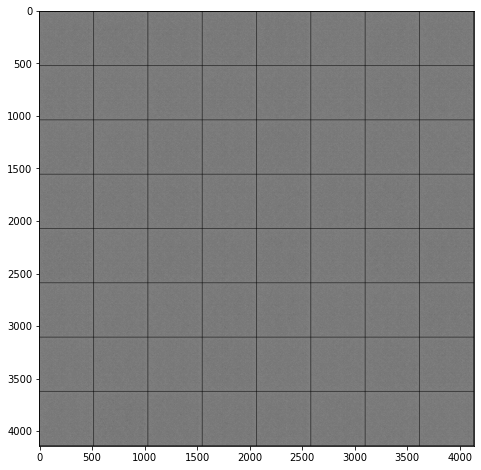

plotted the first generated image


In [ ]:
if cont == 0:
  plt.figure(figsize=(8,8))
  plt.imshow((img_list[0].cpu()), cmap='gray', vmin=0, vmax=1)
    # grid was normalized from make_grid so value is 0~1
    # since the images were output of the model on GPU, we have to convert them to host CPU memory for plt to work
  plt.savefig(pwd+"/result_figs/first_gen")
  plt.show()
  print("plotted the first generated image")

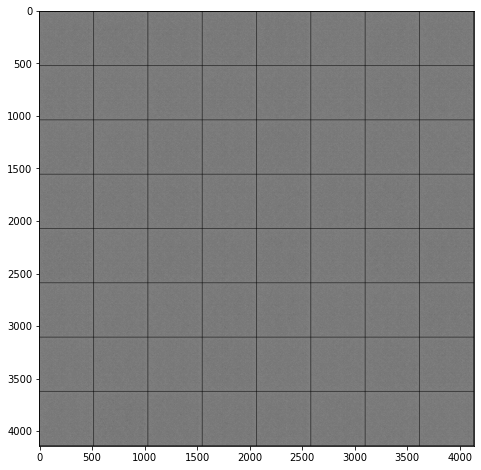

plotted the last generated image


In [ ]:
plt.figure(figsize=(8,8))
plt.imshow((img_list[-1].cpu()), cmap='gray', vmin=0, vmax=1)
  # grid was normalized so value is 0~1
plt.savefig(pwd+"/result_figs/last_gen")
plt.show()
print("plotted the last generated image")

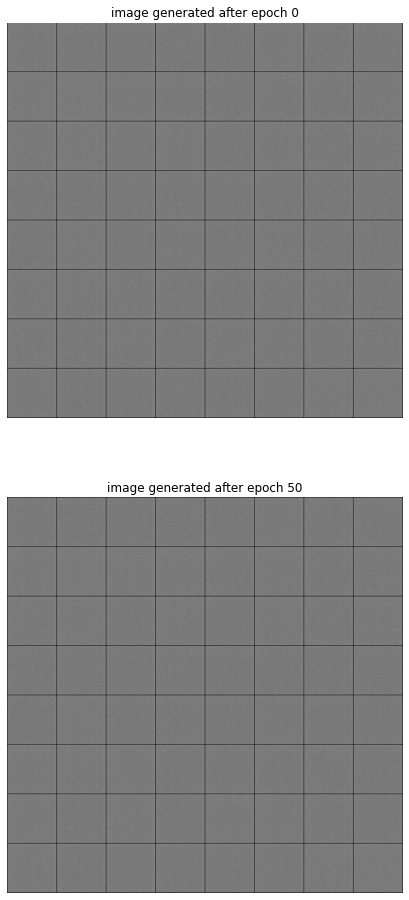

plotted the last imgs generated after every 50 epochs


In [ ]:
plt.figure(figsize=(8,int(8*len(last_imgs))))
  # width 8, height 8*number of images
for i in range(0, len(last_imgs)):
  plt.subplot(len(last_imgs), 1, i+1)
    # add len(last_imgs) rows and 1 column of subplots, this will be the i-th subplot of them
    # the first subplot is indexed 1, not 0!
  plt.axis("off")
  plt.title("image generated after epoch {}".format(i*50))
  plt.imshow(last_imgs[i], cmap='gray', vmin=0, vmax=1)
plt.savefig(pwd+"/result_figs/last_imgs")
plt.show()
print("plotted the last imgs generated after every {} epochs".format(num_epochs))

## Results

Finally, lets check out how we did. Here, we will look at three different results. First, we will see how `D` and `G`’s losses changed during training. Second, we will visualize `G`’s output on the fixed_noise batch for every epoch. And third, we will look at a batch of real data next to a batch of fake data from `G`.

### Loss versus training iteration

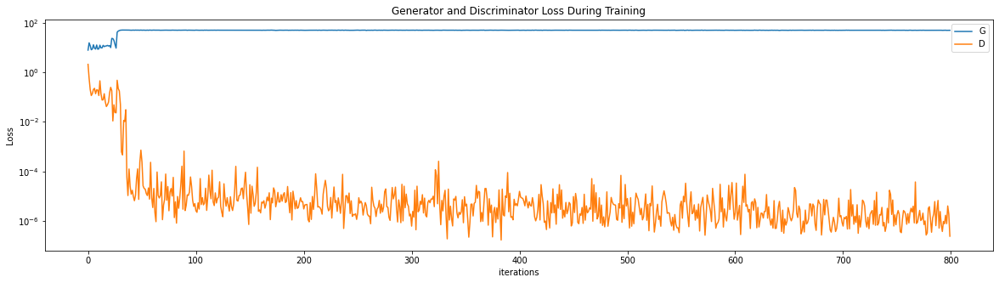

plotted the model losses


In [ ]:
plt.figure(figsize=(int(10*len(last_imgs)),5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.yscale('log')
plt.legend()
plt.savefig(pwd+"/result_figs/GD_loss_plot")
plt.show()
print("plotted the model losses")

### Real Images vs. Fake Images

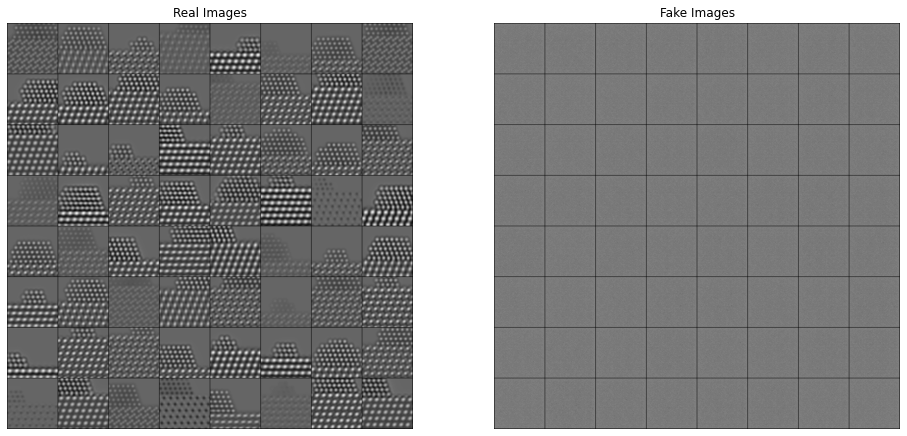

plotted real vs fake image


In [ ]:
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(16,8))
plt.subplot(1,2,1)
  # add 1 row and 2 columns of subplots, this will be the first of them
plt.axis("off")
plt.title("Real Images")
plt.imshow((vutils.make_grid(real_batch[0][:batch_size], nrow=8, padding=5, normalize=True))[0], cmap='gray', vmin=0, vmax=1)

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
  # add 1 row and 2 columns of subplots, this will be the second of them
plt.axis("off")
plt.title("Fake Images")
plt.imshow(img_list[-1], cmap='gray', vmin=0, vmax=1)
plt.savefig(pwd+"/result_figs/real_vs_fake")
plt.show()
print("plotted real vs fake image")

### Visualization of G’s progression

Remember how we saved the generator’s output on the fixed_noise batch after every epoch of training. Now, we can visualize the training progression of `G` with an animation. Press the play button to start the animation.

In [ ]:
# Set up formatting for the movie files
Writer = animation.writers['ffmpeg']
writer = Writer(fps=10, metadata=dict(artist='Me'), bitrate=1800)

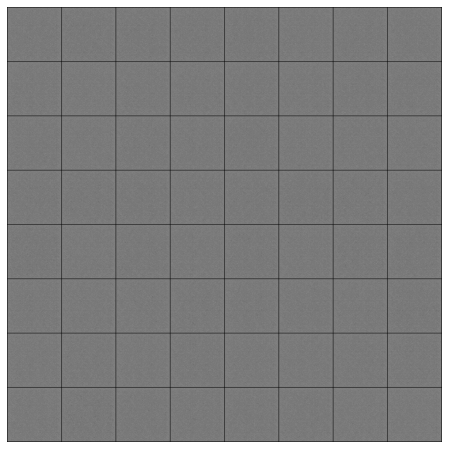

In [ ]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow((i.cpu()), animated=True, cmap='gray')] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
ani.save(pwd+"/result_figs/G_progress_e{}~{}.mp4".format(start_epoch, start_epoch+num_epochs-1), writer=writer)
  # save the animation to a mp4 video file

HTML(ani.to_jshtml())

# symmetric architecture and pure adversarial loss

In [ ]:
pwd = "train_basic"

In [ ]:
# 0 if you want to start a fresh training, 1 if you want to continue where you left off
cont = int(input("continue trianing? "))

continue trianing? 1


In [ ]:
if cont == 1:
  start_epoch = int(input("enter the epoch number from which you'd like to continue training: "))
  print("please make sure that model trained from epoch {} exists".format(start_epoch-1))

enter the epoch number from which you'd like to continue training: 51
please make sure that model trained from epoch 50 exists


In [ ]:
num_epochs= 50

In [ ]:
# reinitialize the models and optimizer
try:
  del netG
  del netD
  del optimizerD
  del optimizerG
  del fixed_noise
  del criterion
  print('deleted')
except:
  print("models don't exist yet")

deleted


In [ ]:
print(pwd)

try:
  os.mkdir(pwd)
  # for storing saved models
except:
  print('directory already exists')

# os.chdir("train_basic")
  # we CANNOT change the current pwd because then the dataloader object cannot queue the data files
  # the dataloader objects queues the data files from the paths we gave it previously, which is no longer visible if we change our pwd
  # just manually add it to all paths below

train_basic
directory already exists


In [ ]:
try:
  os.mkdir(pwd+'/model_checkpoints')
  # for storing saved models
except:
  print('directory already exists')

try:
  os.mkdir(pwd+'/result_figs')
  # for storing figure outputs
except:
  print('directory already exists')

directory already exists
directory already exists


In [ ]:
if cont == 0:
  print("starting fresh training...")
  # Create the generator
  netG = Generator(ngpu).to(device) # moves the model to the GPU
  # Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
  netG.apply(weights_init)
else:
  print("continue training from saved models...")
  path = pwd+"/model_checkpoints/e"+str(start_epoch-1)+"_G"
    # for ex, "model_checkpoints/e400_G"
  netG = torch.load(path).to(device) # moves the model to the GPU
  # the correct generator class (compatible with the model saved) must be defined in order for the saved model to be loaded

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
      # Implements data parallelism at the module level.

# Print the model structure
print(netG)

if cont == 0:
  # Create the Discriminator
  netD = Discriminator(ngpu).to(device)
  # Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
  netD.apply(weights_init)
else:
  path = pwd+"/model_checkpoints/e"+str(start_epoch-1)+"_D"
    # for ex, "model_checkpoints/e400_D"
  netD = torch.load(path).to(device)# moves the model to the GPU
  # the correct discriminator class (compatible with the model saved) must be defined in order for the saved model to be loaded

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Print the model
print(netD)

continue training from saved models...
Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), paddi

In [ ]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create a batch of 64 different latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(batch_size, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.
real_label_G = 1.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
print(lr)

0.0001


In [ ]:
print("we have {} samples and {} samples per batch, we will have {} batches overall".format(
    len(folder_data), batch_size, len(dataloader)
))
print("there are {} samples in our fixed test set".format(len(fixed_noise)))

we have 1000 samples and 64 samples per batch, we will have 16 batches overall
there are 64 samples in our fixed test set


In [ ]:
# Lists to keep track of progress
if cont == 0:
  logs = dict()
  G_losses = []
  D_losses = []
  start_epoch = 1
  img_list = []
  last_imgs = []
else:
  with open(pwd+"/logs.json", 'r') as fp:
    logs = json.load(fp)
  G_losses = logs["G_losses"]
  D_losses = logs["D_losses"]
  # start_epoch = logs["start_epoch"]
  # img_list = torch.load("img_list.ts")
    # this takes too much RAM, we will load this in later if needed
  img_list = []
  last_imgs = torch.load(pwd+"/last_imgs.ts")

In [ ]:

iters = 1
checker = 0

print("Starting Training Loop From Epoch {}".format(start_epoch))
# For each epoch
for epoch in range(start_epoch, start_epoch+num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        # i is the batch number
        # data[0] is the list of samples containing batch_size many samples
        # data[1] is the list of corresponding labels but in this case is meaningless, we will create our own labels

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch----------------------------------------------------------------------------
        
        netD.zero_grad() 
          # zero the gradients of model netD, must be done at the start of each batch
        
        # Format batch:
        real_input = data[0].to(device);
          # real image inputs as input to the model 
        
        # if epoch == 1 and i == 0: print(real_input.size())
          
        b_size = real_input.size(0) 
          # number of samples in the current batch
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device) 
          # create a tensor of real labels all as 1 same length as the number of samples in the current batch
          # we can't directly use batch_size here because in the last batch there might be less samples
        
        # Forward pass real batch through D:
        output = netD(real_input).view(-1)
        
        # Calculate loss on all-real batch
        errD_real = criterion(output, label) 
          # computes the loss itself
          # when updating the discriminator, we want to minimize the difference between the D output and 1 for real samples
        
        # Calculate gradients for D in backward pass
        errD_real.backward() 
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netD
        D_x = output.mean().item()
          # compute the mean of the probability predictions for this batch of real images for checking

        ## Train with all-fake batch----------------------------------------------------------------------------
        
        # Generate batch of random latent vectors z, this is randomly generated for every new batch and not fixed
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        
        # Generate a fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label) # create a tensor of fake labels all as 0
        
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
          # computes the loss itself
          # when updating the discriminator, we want to minimize the difference between the D output and 0 for fake samples
        
        # Calculate the gradients for this batch
        errD_fake.backward()
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netD
          # since torch accumulates gradients, and you didn't zero out your gradient after the update above
          # this simply addes the gradient values to the previous gradient values
          # since we want to minimize both fake and real error (w.r.t. to the different label tensors), their sum will also be a goal of us to minimize
        D_G_z1 = output.mean().item()
          # compute the mean of the probability predictions for this batch for checking
        
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
          # this is only for our viewing sake
          # when we called .backward() on both losses the, their gradients were automatically added in the model already
        
        # Update D
        optimizerD.step()
          # update each parameter value in netD according to the gradient values stored for each parameter

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        
        netG.zero_grad()
          # zero the gradients of model netG, must be done at the start of each batch
        label.fill_(real_label_G) 
          # fake images are considered real for the generator cost 
          # because we want the D's output to be close to the classifying them as real
          # remember, the loss is just a measure of how different our prediction is from our result
          # and we update our model to minimize that difference
          # when updating the generator model, we want to minimize the difference between the D output and 1
        
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        
        #Calculate G's loss based on this output
        errG = criterion(output, label)
        
        # Calculate gradients for G
        errG.backward()
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netG
        D_G_z2 = output.mean().item()
          # compute the mean of the probability predictions for this batch for checking
        
        # Update G
        optimizerG.step()
          # update each parameter value in netD according to the gradient values stored for each parameter

        # Output training stats
        if i % 5 == 0 or (i+1) % len(dataloader) == 0: # every 5 batches and the last batch in every epoch
            print('epoch[%d/%d] batch[%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, start_epoch+num_epochs-1, i+1, len(dataloader),errD.item(), errG.item(), D_x, D_G_z1, D_G_z2)
                  )
              # the .item() extract the actual numeric result out of the tensor(~, device='cuda:0') output
            if errD.item() == 0 or errG.item() == 0: # if model enters training failure mode
                checker+=1
            else: # reset checker
                checker=0

            if checker > 50:
                print("training stuck for more than 50 checks, stopping it early")
                break;

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        # for every 50 iterations, and the last batch on the last epoch
        # predict on fixed_noise and generate validation images to get an idea of how well the model is going
        if (iters % 50 == 0) or ((epoch == start_epoch+num_epochs-1) and (i == len(dataloader)-1)):
            print("validating on fixed noise: iteraton %d, epoch %d, batch number %d"% (iters,epoch, i+1))
            
            with torch.no_grad():
            # stops the autograd engine from calculating the gradients, saves time and space
            # which is the recommended way of doing validation
                fake = netG(fixed_noise).detach().cpu()
                  # send it to cpu here because we don't need anything from the gpu to deal with these results
            
            # print(torch.equal(vutils.make_grid(fake, padding=2, normalize=True)[0], vutils.make_grid(fake, padding=2, normalize=True)[1]))
            #   # just re-confirms that all channels of the grid image is the same b/c we are greyscale
            img_list.append(vutils.make_grid(fake, nrow=8, padding=5, normalize=True)[0])
              # make a grid out of the 64 generated images into 1 entire image and add it to list

        iters += 1
    # also save models as checkpoints after each epoch incase training gets interrupted 
    print("model saved on iteration {}, epoch {}, batch {} with G_loss ={}".format(iters-1 ,epoch, i+1, errG.item()))
    torch.save(netG, pwd+'/model_checkpoints/e{}_G'.format(epoch))
    torch.save(netD, pwd+'/model_checkpoints/e{}_D'.format(epoch))
    print(120*'-')
    print() 

last_imgs.append(img_list[-1].cpu())

Starting Training Loop From Epoch 51
epoch[51/100] batch[1/16]	Loss_D: 0.0000	Loss_G: 43.0479	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
epoch[51/100] batch[6/16]	Loss_D: 0.0000	Loss_G: 23.6360	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
epoch[51/100] batch[11/16]	Loss_D: 0.7731	Loss_G: 32.0015	D(x): 0.9994	D(G(z)): 0.3818 / 0.0000
epoch[51/100] batch[16/16]	Loss_D: 0.0002	Loss_G: 45.1263	D(x): 0.9998	D(G(z)): 0.0000 / 0.0000
model saved on iteration 16, epoch 51, batch 16 with G_loss =45.12626647949219
------------------------------------------------------------------------------------------------------------------------
epoch[52/100] batch[1/16]	Loss_D: 0.0003	Loss_G: 45.1605	D(x): 0.9997	D(G(z)): 0.0000 / 0.0000
epoch[52/100] batch[6/16]	Loss_D: 0.0003	Loss_G: 45.6376	D(x): 0.9997	D(G(z)): 0.0000 / 0.0000
epoch[52/100] batch[11/16]	Loss_D: 0.0001	Loss_G: 45.6252	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000
epoch[52/100] batch[16/16]	Loss_D: 0.0001	Loss_G: 45.6568	D(x): 0.9999	D(G(z)): 0.0000 / 0.0000

In [ ]:
# save the losses and the validation images so we can re-visit them later
torch.save(img_list, pwd+"img_list_e{}~{}.ts".format(start_epoch, start_epoch+num_epochs-1))
torch.save(last_imgs, pwd+"/last_imgs.ts")
  # since this list contains tensors, we cannot save with Json
logs["G_losses"] = G_losses
logs["D_losses"] = D_losses
# logs["start_epoch"] = epoch+1
with open(pwd+"/logs.json", 'w') as fp:
    json.dump(logs, fp)

In [ ]:
img_list2 = torch.load(pwd+"/img_list.ts")

In [ ]:
for i in range(3):
  print(torch.equal(img_list2[i], img_list[i]))

True
True
True


In [ ]:
print("number of grids saved in G's progression: ", len(img_list))

number of grids saved in G's progression:  32


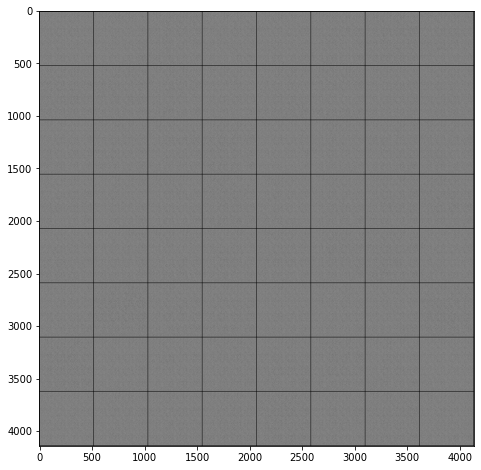

plotted the first generated image


In [ ]:
if cont == 0:
  plt.figure(figsize=(8,8))
  plt.imshow((img_list[0].cpu()), cmap='gray', vmin=0, vmax=1)
    # grid was normalized from make_grid so value is 0~1
    # since the images were output of the model on GPU, we have to convert them to host CPU memory for plt to work
  plt.savefig(pwd+"/result_figs/first_gen")
  plt.show()
  print("plotted the first generated image")

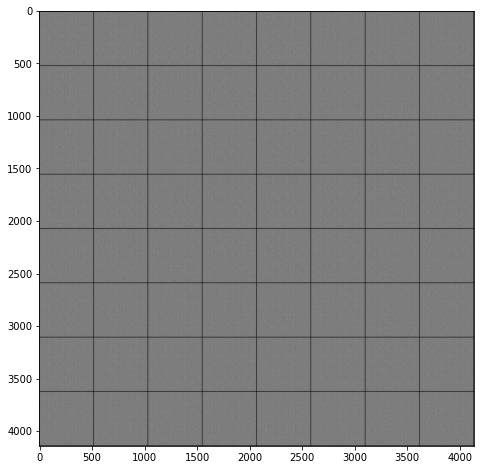

plotted the last generated image


In [ ]:
plt.figure(figsize=(8,8))
plt.imshow((img_list[-1].cpu()), cmap='gray', vmin=0, vmax=1)
  # grid was normalized so value is 0~1
plt.savefig(pwd+"/result_figs/last_gen")
plt.show()
print("plotted the last generated image")

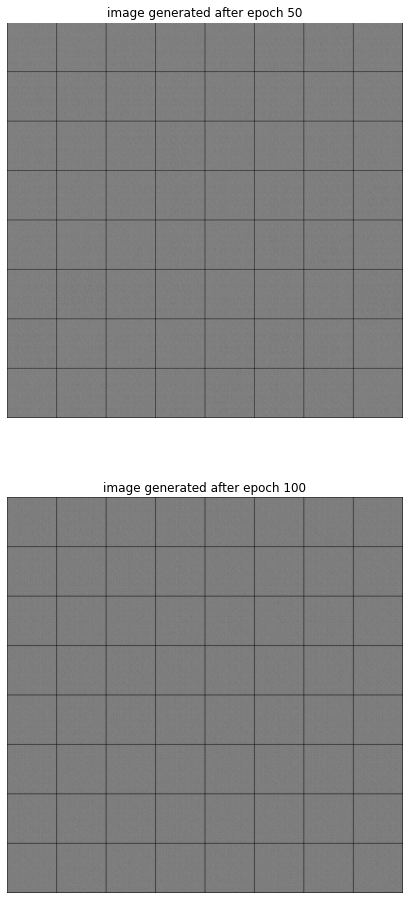

plotted the last imgs generated after every 50 epochs


In [ ]:
plt.figure(figsize=(8,int(8*len(last_imgs))))
  # width 8, height 8*number of images
for i in range(1, len(last_imgs)+1):
  plt.subplot(len(last_imgs), 1, i)
    # add len(last_imgs) rows and 1 column of subplots, this will be the ith of them
  plt.axis("off")
  plt.title("image generated after epoch {}".format(i*num_epochs))
  plt.imshow(last_imgs[i-1], cmap='gray', vmin=0, vmax=1)
plt.savefig(pwd+"/result_figs/last_imgs")
plt.show()
print("plotted the last imgs generated after every {} epochs".format(num_epochs))

## Results

Finally, lets check out how we did. Here, we will look at three different results. First, we will see how `D` and `G`’s losses changed during training. Second, we will visualize `G`’s output on the fixed_noise batch for every epoch. And third, we will look at a batch of real data next to a batch of fake data from `G`.

### Loss versus training iteration

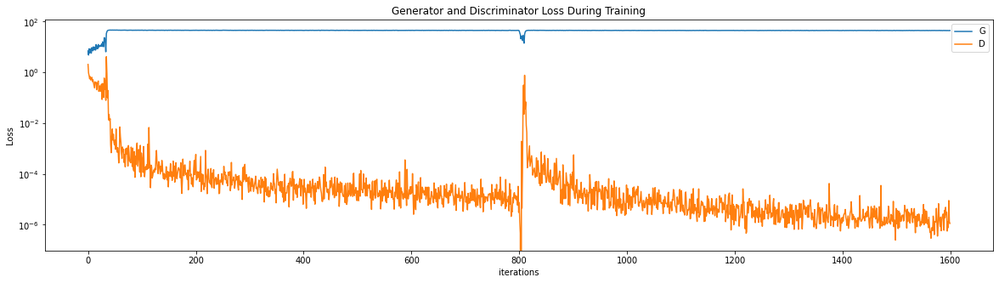

plotted the model losses


In [ ]:
plt.figure(figsize=(int(10*len(last_imgs)),5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.yscale('log')
plt.legend()
plt.savefig(pwd+"/result_figs/GD_loss_plot")
plt.show()
print("plotted the model losses")

### Real Images vs. Fake Images

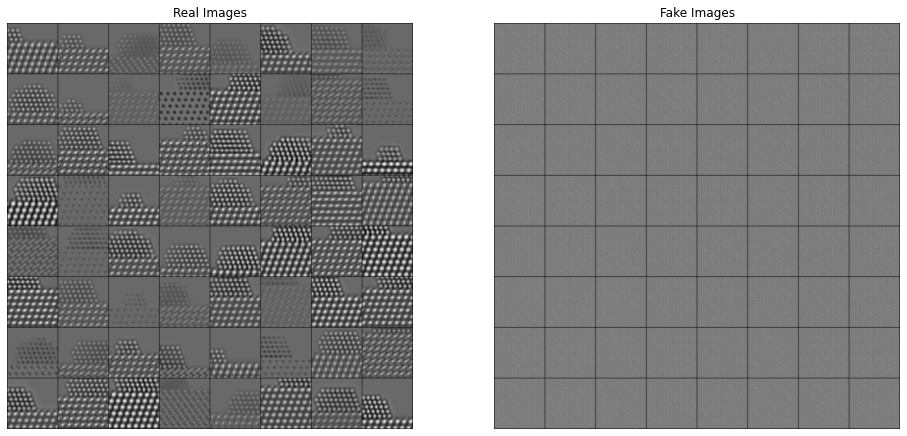

plotted real vs fake image


In [ ]:
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(16,8))
plt.subplot(1,2,1)
  # add 1 row and 2 columns of subplots, this will be the first of them
plt.axis("off")
plt.title("Real Images")
plt.imshow((vutils.make_grid(real_batch[0][:batch_size], nrow=8, padding=5, normalize=True))[0], cmap='gray', vmin=0, vmax=1)

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
  # add 1 row and 2 columns of subplots, this will be the second of them
plt.axis("off")
plt.title("Fake Images")
plt.imshow(img_list[-1], cmap='gray', vmin=0, vmax=1)
plt.savefig(pwd+"/result_figs/real_vs_fake")
plt.show()
print("plotted real vs fake image")

### Visualization of G’s progression

Remember how we saved the generator’s output on the fixed_noise batch after every epoch of training. Now, we can visualize the training progression of `G` with an animation. Press the play button to start the animation.

In [ ]:
# Set up formatting for the movie files
Writer = animation.writers['ffmpeg']
writer = Writer(fps=10, metadata=dict(artist='Me'), bitrate=1800)

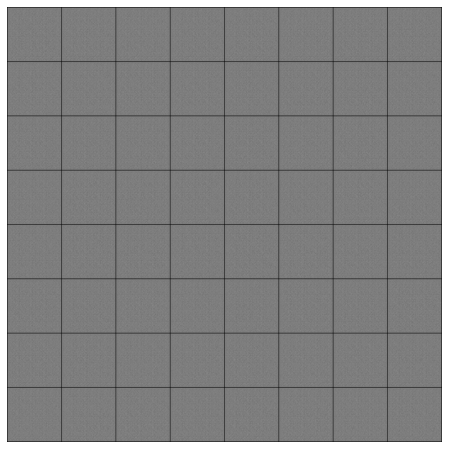

In [ ]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow((i.cpu()), animated=True, cmap='gray')] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
ani.save(pwd+"/result_figs/G_progress_e{}~{}.mp4", writer=writer)
  # save the animation to a mp4 video file

HTML(ani.to_jshtml())

# example trial - no `sigmoide()` w/ `BCELogitLoss`

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is an real or generated image of shape (nc) x 512 x 512
            nn.Conv2d(nc, ndf, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf) x 256 x 256, where 256 = (n+2p-k)/s+1 = (512+2-4)/2+1 
            nn.Conv2d(ndf, ndf , 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf) x 128 x 128, where 128 = (n+2p-k)/s+1 = (256+2-4)/2+1 
            nn.Conv2d(ndf, ndf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf) x 64 x 64, where 64 = (n+2p-k)/s+1 = (128+2-4)/2+1 
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*2) x 32 x 32, where 32 = (n+2p-k)/s+1 = (64+2-4)/2+1
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*4) x 16 x 16, where 16 = (n+2p-k)/s+1 = (32+2-4)/2+1
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*8) x 8 x 8, where 8 = (n+2p-k)/s+1 = (16+2-4)/2+1  
            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*16) x 4 x 4, where 4 = (n+2p-k)/s+1 = (8+2-4)/2+1  
            nn.Conv2d(ndf * 16, 1, kernel_size=4, stride=1, padding=0, bias=False),
              # state size. 1 x 1 x 1, where 1 = (n+2p-k)/s+1 = (4+0-4)/1+1 
            # nn.Sigmoid()
              # removed since we are using BCEWithLogitsLoss
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
pwd = "train_BCELogit"

In [ ]:
print("0 if you want to start a fresh training, 1 if you want to continue where you left off")
cont = int(input("continue trianing? "))

0 if you want to start a fresh training, 1 if you want to continue where you left off
continue trianing? 1


In [ ]:
if cont == 1:
  start_epoch = int(input("enter the epoch number from which you'd like to continue training: "))
  print("please make sure that model trained from epoch {} exists".format(start_epoch-1))

enter the epoch number from which you'd like to continue training: 51
please make sure that model trained from epoch 50 exists


In [ ]:
num_epochs= 50

In [ ]:
# reinitialize the models and optimizer
try:
  del netG
  del netD
  del optimizerD
  del optimizerG
  del fixed_noise
  del criterion
  print('deleted')
except:
  print("models don't exist yet")

deleted


In [ ]:
print(pwd)

try:
  os.mkdir(pwd)
  # for storing saved models
except:
  print('directory already exists')

# os.chdir("train_basic")
  # we CANNOT change the current pwd because then the dataloader object cannot queue the data files
  # the dataloader objects queues the data files from the paths we gave it previously, which is no longer visible if we change our pwd
  # just manually add it to all paths below

train_BCELogit
directory already exists


In [ ]:
try:
  os.mkdir(pwd+'/model_checkpoints')
  # for storing saved models
except:
  print('directory already exists')

try:
  os.mkdir(pwd+'/result_figs')
  # for storing figure outputs
except:
  print('directory already exists')

directory already exists
directory already exists


In [ ]:
if cont == 0:
  print("starting fresh training...")
  # Create the generator
  netG = Generator(ngpu).to(device) # moves the model to the GPU
  # Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
  netG.apply(weights_init)
else:
  print("continue training from saved models...")
  path = pwd+"/model_checkpoints/e"+str(start_epoch-1)+"_G"
    # for ex, "model_checkpoints/e400_G"
  netG = torch.load(path).to(device) # moves the model to the GPU
  # the correct generator class (compatible with the model saved) must be defined in order for the saved model to be loaded

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
      # Implements data parallelism at the module level.

# Print the model structure
print(netG)

if cont == 0:
  # Create the Discriminator
  netD = Discriminator(ngpu).to(device)
  # Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
  netD.apply(weights_init)
else:
  path = pwd+"/model_checkpoints/e"+str(start_epoch-1)+"_D"
    # for ex, "model_checkpoints/e400_D"
  netD = torch.load(path).to(device)# moves the model to the GPU
  # the correct discriminator class (compatible with the model saved) must be defined in order for the saved model to be loaded

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Print the model
print(netD)

continue training from saved models...
Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), paddi

In [ ]:
# Initialize BCELoss function
criterion = nn.BCEWithLogitsLoss()
  # This loss combines a Sigmoid layer and the BCELoss in one single class. 
  # This version is more numerically stable than using a plain Sigmoid followed by a BCELoss 
  # as, by combining the operations into one layer,we take advantage of the log-sum-exp trick for numerical stability.
  # learn more here https://github.com/soumith/ganhacks/issues/36
# So we also have to go back to our discriminator to remove the last sigmoid layer

# Create a batch of 64 different latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(batch_size, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.
real_label_G = 1.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
print(lr)

0.0001


In [ ]:
print("we have {} samples and {} samples per batch, we will have {} batches overall".format(
    len(folder_data), batch_size, len(dataloader)
))
print("there are {} samples in our fixed test set".format(len(fixed_noise)))

we have 1000 samples and 64 samples per batch, we will have 16 batches overall
there are 64 samples in our fixed test set


In [ ]:
# Lists to keep track of progress
if cont == 0:
  logs = dict()
  G_losses = []
  D_losses = []
  start_epoch = 1
  img_list = []
  last_imgs = []
else:
  with open(pwd+"/logs.json", 'r') as fp:
    logs = json.load(fp)
  G_losses = logs["G_losses"]
  D_losses = logs["D_losses"]
  img_list = torch.load(pwd+"/img_list.ts")
  last_imgs = torch.load(pwd+"/last_imgs.ts")

In [ ]:
iters = 1
checker = 0

print("Starting Training Loop From Epoch {}".format(start_epoch))
# For each epoch
for epoch in range(start_epoch, start_epoch+num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        # i is the batch number
        # data[0] is the list of samples containing batch_size many samples
        # data[1] is the list of corresponding labels but in this case is meaningless, we will create our own labels

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch----------------------------------------------------------------------------
        
        netD.zero_grad() 
          # zero the gradients of model netD, must be done at the start of each batch
        
        # Format batch:
        real_input = data[0].to(device);
          # real image inputs as input to the model 
        
        # if epoch == 1 and i == 0: print(real_input.size())
          
        b_size = real_input.size(0) 
          # number of samples in the current batch
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device) 
          # create a tensor of real labels all as 1 same length as the number of samples in the current batch
          # we can't directly use batch_size here because in the last batch there might be less samples
        
        # Forward pass real batch through D:
        output = netD(real_input).view(-1)
        
        # Calculate loss on all-real batch
        errD_real = criterion(output, label) 
          # computes the loss itself
          # when updating the discriminator, we want to minimize the difference between the D output and 1 for real samples
        
        # Calculate gradients for D in backward pass
        errD_real.backward() 
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netD
        D_x = output.mean().item()
          # compute the mean of the probability predictions for this batch of real images for checking

        ## Train with all-fake batch----------------------------------------------------------------------------
        
        # Generate batch of random latent vectors z, this is randomly generated for every new batch and not fixed
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        
        # Generate a fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label) # create a tensor of fake labels all as 0
        
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
          # computes the loss itself
          # when updating the discriminator, we want to minimize the difference between the D output and 0 for fake samples
        
        # Calculate the gradients for this batch
        errD_fake.backward()
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netD
          # since torch accumulates gradients, and you didn't zero out your gradient after the update above
          # this simply addes the gradient values to the previous gradient values
          # since we want to minimize both fake and real error (w.r.t. to the different label tensors), their sum will also be a goal of us to minimize
        D_G_z1 = output.mean().item()
          # compute the mean of the probability predictions for this batch for checking
        
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
          # this is only for our viewing sake
          # when we called .backward() on both losses the, their gradients were automatically added in the model already
        
        # Update D
        optimizerD.step()
          # update each parameter value in netD according to the gradient values stored for each parameter

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        
        netG.zero_grad()
          # zero the gradients of model netG, must be done at the start of each batch
        label.fill_(real_label_G) 
          # fake images are considered real for the generator cost 
          # because we want the D's output to be close to the classifying them as real
          # remember, the loss is just a measure of how different our prediction is from our result
          # and we update our model to minimize that difference
          # when updating the generator model, we want to minimize the difference between the D output and 1
        
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        
        #Calculate G's loss based on this output
        errG = criterion(output, label)
        
        # Calculate gradients for G
        errG.backward()
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netG
        D_G_z2 = output.mean().item()
          # compute the mean of the probability predictions for this batch for checking
        
        # Update G
        optimizerG.step()
          # update each parameter value in netD according to the gradient values stored for each parameter

        # Output training stats
        if i % 5 == 0 or (i+1) % len(dataloader) == 0: # every 5 batches and the last batch in every epoch
            print('epoch[%d/%d] batch[%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, start_epoch+num_epochs-1, i+1, len(dataloader),errD.item(), errG.item(), D_x, D_G_z1, D_G_z2)
                  )
              # the .item() extract the actual numeric result out of the tensor(~, device='cuda:0') output
            if errD.item() == 0 or errG.item() == 0: # if model enters training failure mode
                checker+=1
            else: # reset checker
                checker=0

            if checker > 50:
                print("training stuck for more than 50 checks, stopping it early")
                break;

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        # for every 50 iterations, and the last batch on the last epoch
        # predict on fixed_noise and generate validation images to get an idea of how well the model is going
        if (iters % 50 == 0) or ((epoch == start_epoch+num_epochs-1) and (i == len(dataloader)-1)):
            print("validating on fixed noise: iteraton %d, epoch %d, batch number %d"% (iters,epoch, i+1))
            
            with torch.no_grad():
            # stops the autograd engine from calculating the gradients, saves time and space
            # which is the recommended way of doing validation
                fake = netG(fixed_noise).detach().cpu()
                  # send it to cpu here because we don't need anything from the gpu to deal with these results
            
            # print(torch.equal(vutils.make_grid(fake, padding=2, normalize=True)[0], vutils.make_grid(fake, padding=2, normalize=True)[1]))
            #   # just re-confirms that all channels of the grid image is the same b/c we are greyscale
            img_list.append(vutils.make_grid(fake, nrow=8, padding=5, normalize=True)[0])
              # make a grid out of the 64 generated images into 1 entire image and add it to list

        iters += 1
    # also save models as checkpoints after each epoch incase training gets interrupted 
    print("model saved on iteration {}, epoch {}, batch {} with G_loss ={}".format(iters-1 ,epoch, i+1, errG.item()))
    torch.save(netG, pwd+'/model_checkpoints/e{}_G'.format(epoch))
    torch.save(netD, pwd+'/model_checkpoints/e{}_D'.format(epoch))
    print(120*'-')
    print() 

last_imgs.append(img_list[-1].cpu())

Starting Training Loop From Epoch 51
epoch[51/100] batch[1/16]	Loss_D: 0.0308	Loss_G: 39.4612	D(x): 10.1260	D(G(z)): -4.0679 / -39.4612
epoch[51/100] batch[6/16]	Loss_D: 0.0004	Loss_G: 34.5447	D(x): 12.1122	D(G(z)): -33.9926 / -34.5447
epoch[51/100] batch[11/16]	Loss_D: 0.0001	Loss_G: 26.2742	D(x): 12.7898	D(G(z)): -26.2671 / -26.2742
epoch[51/100] batch[16/16]	Loss_D: 0.0000	Loss_G: 19.5351	D(x): 14.8501	D(G(z)): -19.5414 / -19.5351
model saved on iteration 16, epoch 51, batch 16 with G_loss =19.53513526916504
------------------------------------------------------------------------------------------------------------------------

epoch[52/100] batch[1/16]	Loss_D: 0.0000	Loss_G: 17.1642	D(x): 14.8337	D(G(z)): -17.1687 / -17.1642
epoch[52/100] batch[6/16]	Loss_D: 0.0000	Loss_G: 11.3222	D(x): 14.6015	D(G(z)): -11.0903 / -11.3221
epoch[52/100] batch[11/16]	Loss_D: 0.0001	Loss_G: 11.2746	D(x): 13.4916	D(G(z)): -10.1292 / -11.2746
epoch[52/100] batch[16/16]	Loss_D: 0.0001	Loss_G: 11.2396	D(

In [ ]:
# save the losses and the validation images so we can re-visit them later
torch.save(img_list, pwd+"/img_list.ts")
torch.save(last_imgs, pwd+"/last_imgs.ts")
  # since this list contains tensors, we cannot save with Json
logs["G_losses"] = G_losses
logs["D_losses"] = D_losses
# logs["start_epoch"] = epoch+1
with open(pwd+"/logs.json", 'w') as fp:
    json.dump(logs, fp)

In [ ]:
print("number of grids saved in G's progression: ", len(img_list))

number of grids saved in G's progression:  32


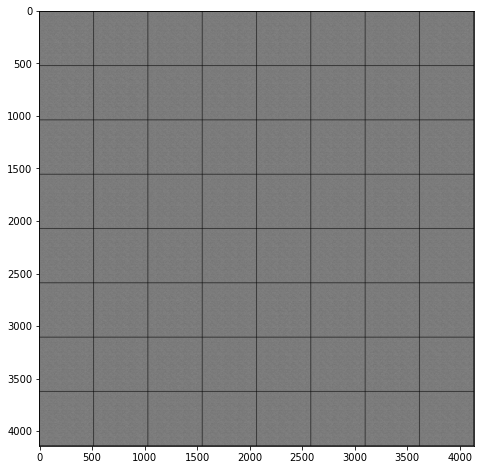

plotted the first generated image


In [ ]:
plt.figure(figsize=(8,8))
plt.imshow((img_list[0].cpu()), cmap='gray', vmin=0, vmax=1)
  # grid was normalized from make_grid so value is 0~1
  # since the images were output of the model on GPU, we have to convert them to host CPU memory for plt to work
plt.savefig(pwd+"/result_figs/first_gen")
plt.show()
print("plotted the first generated image")

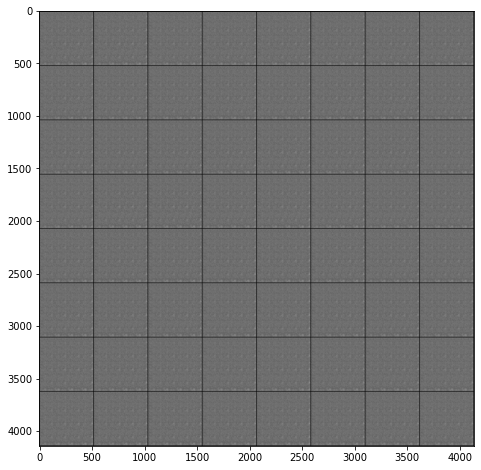

plotted the last generated image


In [ ]:
plt.figure(figsize=(8,8))
plt.imshow((img_list[-1].cpu()), cmap='gray', vmin=0, vmax=1)
  # grid was normalized so value is 0~1
plt.savefig(pwd+"/result_figs/last_gen")
plt.show()
print("plotted the last generated image")

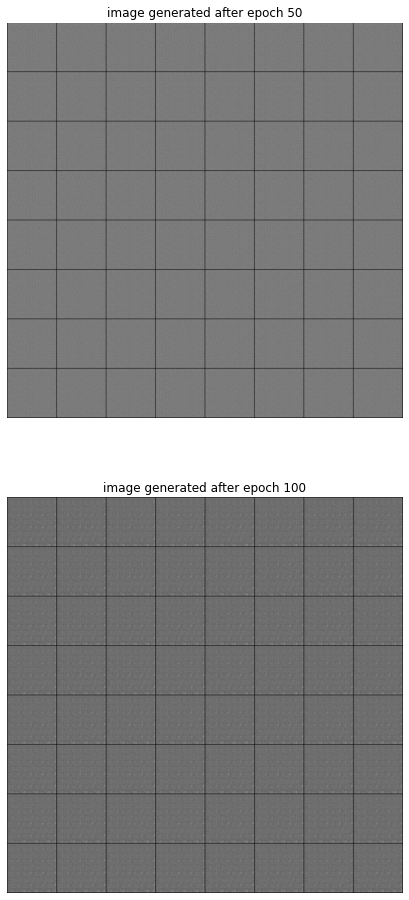

plotted the last imgs generated after every 50 epochs


In [ ]:
plt.figure(figsize=(8,int(8*len(last_imgs))))
  # width 8, height 8*number of images
for i in range(1, len(last_imgs)+1):
  plt.subplot(len(last_imgs), 1, i)
    # add len(last_imgs) rows and 1 column of subplots, this will be the ith of them
  plt.axis("off")
  plt.title("image generated after epoch {}".format(i*num_epochs))
  plt.imshow(last_imgs[i-1], cmap='gray', vmin=0, vmax=1)
plt.savefig(pwd+"/result_figs/last_imgs")
plt.show()
print("plotted the last imgs generated after every {} epochs".format(num_epochs))

## Results

Finally, lets check out how we did. Here, we will look at three different results. First, we will see how `D` and `G`’s losses changed during training. Second, we will visualize `G`’s output on the fixed_noise batch for every epoch. And third, we will look at a batch of real data next to a batch of fake data from `G`.

### Loss versus training iteration

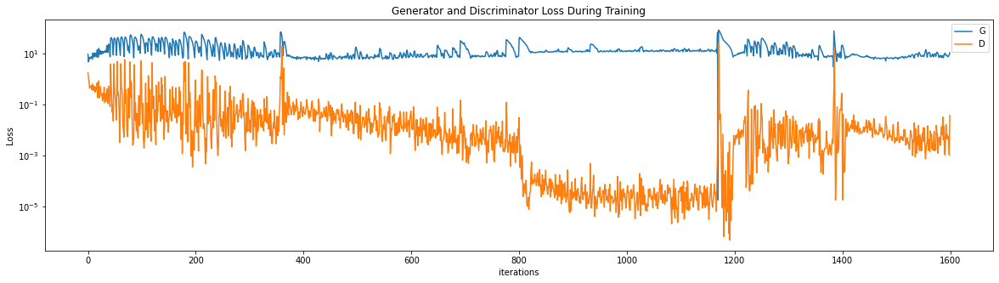

plotted the model losses


In [ ]:
plt.figure(figsize=(int(10*len(last_imgs)),5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.yscale('log')
plt.legend()
plt.savefig(pwd+"/result_figs/GD_loss_plot")
plt.show()
print("plotted the model losses")

### Real Images vs. Fake Images

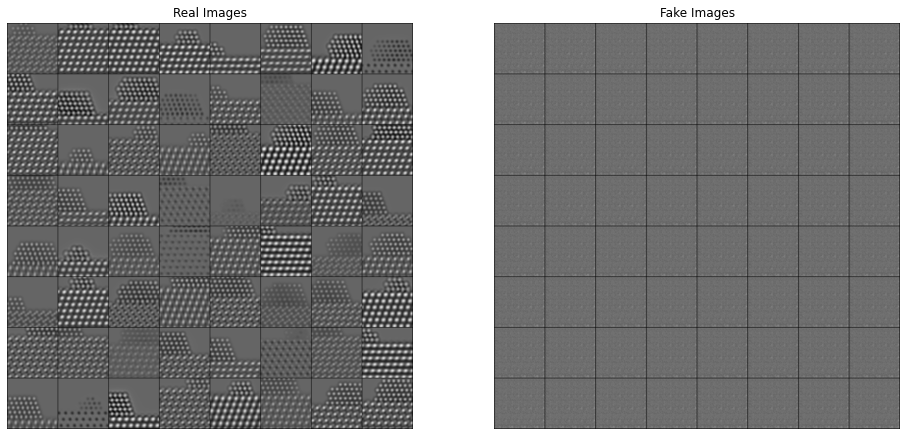

plotted real vs fake image


In [ ]:
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(16,8))
plt.subplot(1,2,1)
  # add 1 row and 2 columns of subplots, this will be the first of them
plt.axis("off")
plt.title("Real Images")
plt.imshow((vutils.make_grid(real_batch[0][:batch_size], nrow=8, padding=5, normalize=True))[0], cmap='gray', vmin=0, vmax=1)

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
  # add 1 row and 2 columns of subplots, this will be the second of them
plt.axis("off")
plt.title("Fake Images")
plt.imshow(img_list[-1], cmap='gray', vmin=0, vmax=1)
plt.savefig(pwd+"/result_figs/real_vs_fake")
plt.show()
print("plotted real vs fake image")

### Visualization of G’s progression

Remember how we saved the generator’s output on the fixed_noise batch after every epoch of training. Now, we can visualize the training progression of `G` with an animation. Press the play button to start the animation.

In [ ]:
# Set up formatting for the movie files
Writer = animation.writers['ffmpeg']
writer = Writer(fps=10, metadata=dict(artist='Me'), bitrate=1800)

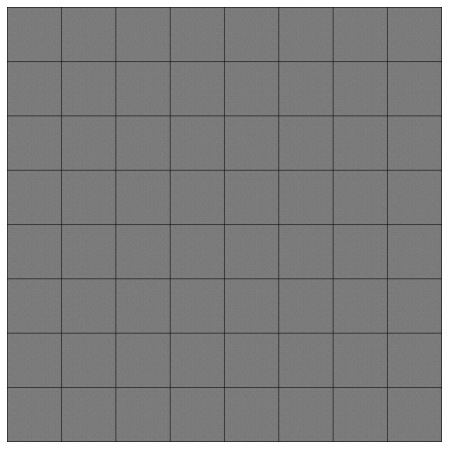

In [ ]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow((i.cpu()), animated=True, cmap='gray')] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
ani.save(pwd+"/result_figs/G_progress.mp4", writer=writer)
  # save the animation to a mp4 video file

HTML(ani.to_jshtml())

# example trial - `0.9` as the real label + no `sigmoid()`

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is an real or generated image of shape (nc) x 512 x 512
            nn.Conv2d(nc, ndf, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf) x 256 x 256, where 256 = (n+2p-k)/s+1 = (512+2-4)/2+1 
            nn.Conv2d(ndf, ndf , 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf) x 128 x 128, where 128 = (n+2p-k)/s+1 = (256+2-4)/2+1 
            nn.Conv2d(ndf, ndf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf) x 64 x 64, where 64 = (n+2p-k)/s+1 = (128+2-4)/2+1 
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*2) x 32 x 32, where 32 = (n+2p-k)/s+1 = (64+2-4)/2+1
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*4) x 16 x 16, where 16 = (n+2p-k)/s+1 = (32+2-4)/2+1
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*8) x 8 x 8, where 8 = (n+2p-k)/s+1 = (16+2-4)/2+1  
            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*16) x 4 x 4, where 4 = (n+2p-k)/s+1 = (8+2-4)/2+1  
            nn.Conv2d(ndf * 16, 1, kernel_size=4, stride=1, padding=0, bias=False),
              # state size. 1 x 1 x 1, where 1 = (n+2p-k)/s+1 = (4+0-4)/1+1 
            # nn.Sigmoid()
              # removed since we are using BCEWithLogitsLoss
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
pwd = "train_BCELogit_0.9"

In [ ]:
print("0 if you want to start a fresh training, 1 if you want to continue where you left off")
# cont = int(input("continue trianing? "))
cont = 1

0 if you want to start a fresh training, 1 if you want to continue where you left off


In [ ]:
if cont == 1:
  # start_epoch = int(input("enter the epoch number from which you'd like to continue training: "))
  start_epoch = 101
  print("please make sure that model trained from epoch {} exists".format(start_epoch-1))

please make sure that model trained from epoch 100 exists


In [ ]:
num_epochs= 50

In [ ]:
# reinitialize the models and optimizer
try:
  del netG
  del netD
  del optimizerD
  del optimizerG
  del fixed_noise
  del criterion
  print('deleted')
except:
  print("models don't exist yet")

deleted


In [ ]:
print(pwd)

try:
  os.mkdir(pwd)
  # for storing saved models
except:
  print('directory already exists')

# os.chdir("train_basic")
  # we CANNOT change the current pwd because then the dataloader object cannot queue the data files
  # the dataloader objects queues the data files from the paths we gave it previously, which is no longer visible if we change our pwd
  # just manually add it to all paths below

train_BCELogit_0.9
directory already exists


In [ ]:
try:
  os.mkdir(pwd+'/model_checkpoints')
  # for storing saved models
except:
  print('directory already exists')

try:
  os.mkdir(pwd+'/result_figs')
  # for storing figure outputs
except:
  print('directory already exists')

directory already exists
directory already exists


In [ ]:
if cont == 0:
  print("starting fresh training...")
  # Create the generator
  netG = Generator(ngpu).to(device) # moves the model to the GPU
  # Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
  netG.apply(weights_init)
else:
  print("continue training from saved models...")
  path = pwd+"/model_checkpoints/e"+str(start_epoch-1)+"_G"
    # for ex, "model_checkpoints/e400_G"
  netG = torch.load(path).to(device) # moves the model to the GPU
  # the correct generator class (compatible with the model saved) must be defined in order for the saved model to be loaded

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
      # Implements data parallelism at the module level.

# Print the model structure
print(netG)

if cont == 0:
  # Create the Discriminator
  netD = Discriminator(ngpu).to(device)
  # Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
  netD.apply(weights_init)
else:
  path = pwd+"/model_checkpoints/e"+str(start_epoch-1)+"_D"
    # for ex, "model_checkpoints/e400_D"
  netD = torch.load(path).to(device)# moves the model to the GPU
  # the correct discriminator class (compatible with the model saved) must be defined in order for the saved model to be loaded

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Print the model
print(netD)

continue training from saved models...
Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), paddi

In [ ]:
# Initialize BCELoss function
criterion = nn.BCEWithLogitsLoss()
  # This loss combines a Sigmoid layer and the BCELoss in one single class. 
  # This version is more numerically stable than using a plain Sigmoid followed by a BCELoss 
  # as, by combining the operations into one layer,we take advantage of the log-sum-exp trick for numerical stability.
  # learn more here https://github.com/soumith/ganhacks/issues/36
# So we also have to go back to our discriminator to remove the last sigmoid layer

# Create a batch of 64 different latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(batch_size, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 0.9
  # label smoothing, from pt7 in https://towardsdatascience.com/10-lessons-i-learned-training-generative-adversarial-networks-gans-for-a-year-c9071159628
real_label_G = 1.0
  # this is the real label we will use for G when trying to fool the D
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
print(lr)

0.0001


In [ ]:
print("we have {} samples and {} samples per batch, we will have {} batches overall".format(
    len(folder_data), batch_size, len(dataloader)
))
print("there are {} samples in our fixed test set".format(len(fixed_noise)))

we have 1000 samples and 64 samples per batch, we will have 16 batches overall
there are 64 samples in our fixed test set


In [ ]:
# Lists to keep track of progress
if cont == 0:
  logs = dict()
  G_losses = []
  D_losses = []
  start_epoch = 1
  img_list = []
  last_imgs = []
else:
  with open(pwd+"/logs.json", 'r') as fp:
    logs = json.load(fp)
  G_losses = logs["G_losses"]
  D_losses = logs["D_losses"]
  # img_list = torch.load(pwd+"/img_list.ts")
    # this takes too much RAM and stops execution, we will load this in later
  img_list = []
  last_imgs = torch.load(pwd+"/last_imgs.ts")

In [ ]:
torch.cuda.empty_cache()
  # this will release all the GPU memory cache that can be freed.
  # this will not delete objects that will has variables referencing them
  # https://discuss.pytorch.org/t/how-can-we-release-gpu-memory-cache/14530
len(img_list)

0

In [ ]:
iters = 1
checker = 0

print("Starting Training Loop From Epoch {}".format(start_epoch))
# For each epoch
for epoch in range(start_epoch, start_epoch+num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        # i is the batch number
        # data[0] is the list of samples containing batch_size many samples
        # data[1] is the list of corresponding labels but in this case is meaningless, we will create our own labels

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch----------------------------------------------------------------------------
        
        netD.zero_grad() 
          # zero the gradients of model netD, must be done at the start of each batch
        
        # Format batch:
        real_input = data[0].to(device);
          # real image inputs as input to the model 
        
        # if epoch == 1 and i == 0: print(real_input.size())
          
        b_size = real_input.size(0) 
          # number of samples in the current batch
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device) 
          # create a tensor of real labels all as 1 same length as the number of samples in the current batch
          # we can't directly use batch_size here because in the last batch there might be less samples
        
        # Forward pass real batch through D:
        output = netD(real_input).view(-1)
        
        # Calculate loss on all-real batch
        errD_real = criterion(output, label) 
          # computes the loss itself
          # when updating the discriminator, we want to minimize the difference between the D output and 1 for real samples
        
        # Calculate gradients for D in backward pass
        errD_real.backward() 
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netD
        D_x = output.mean().item()
          # compute the mean of the probability predictions for this batch of real images for checking

        ## Train with all-fake batch----------------------------------------------------------------------------
        
        # Generate batch of random latent vectors z, this is randomly generated for every new batch and not fixed
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        
        # Generate a fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label) # create a tensor of fake labels all as 0
        
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
          # computes the loss itself
          # when updating the discriminator, we want to minimize the difference between the D output and 0 for fake samples
        
        # Calculate the gradients for this batch
        errD_fake.backward()
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netD
          # since torch accumulates gradients, and you didn't zero out your gradient after the update above
          # this simply addes the gradient values to the previous gradient values
          # since we want to minimize both fake and real error (w.r.t. to the different label tensors), their sum will also be a goal of us to minimize
        D_G_z1 = output.mean().item()
          # compute the mean of the probability predictions for this batch for checking
        
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
          # this is only for our viewing sake
          # when we called .backward() on both losses the, their gradients were automatically added in the model already
        
        # Update D
        optimizerD.step()
          # update each parameter value in netD according to the gradient values stored for each parameter

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        
        netG.zero_grad()
          # zero the gradients of model netG, must be done at the start of each batch
        label.fill_(real_label_G) 
          # fake images are considered real for the generator cost 
          # because we want the D's output to be close to the classifying them as real
          # remember, the loss is just a measure of how different our prediction is from our result
          # and we update our model to minimize that difference
          # when updating the generator model, we want to minimize the difference between the D output and 1
        
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        
        #Calculate G's loss based on this output
        errG = criterion(output, label)
        
        # Calculate gradients for G
        errG.backward()
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netG
        D_G_z2 = output.mean().item()
          # compute the mean of the probability predictions for this batch for checking
        
        # Update G
        optimizerG.step()
          # update each parameter value in netD according to the gradient values stored for each parameter

        # Output training stats
        if i % 5 == 0 or (i+1) % len(dataloader) == 0: # every 5 batches and the last batch in every epoch
            print('epoch[%d/%d] batch[%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, start_epoch+num_epochs-1, i+1, len(dataloader),errD.item(), errG.item(), D_x, D_G_z1, D_G_z2)
                  )
              # the .item() extract the actual numeric result out of the tensor(~, device='cuda:0') output
            if errD.item() == 0 or errG.item() == 0: # if model enters training failure mode
                checker+=1
            else: # reset checker
                checker=0

            if checker > 50:
                print("training stuck for more than 50 checks, stopping it early")
                break;

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        # for every 50 iterations, and the last batch on the last epoch
        # predict on fixed_noise and generate validation images to get an idea of how well the model is going
        if (iters % 50 == 0) or ((epoch == start_epoch+num_epochs-1) and (i == len(dataloader)-1)):
            print("validating on fixed noise: iteraton %d, epoch %d, batch number %d"% (iters,epoch, i+1))
            
            with torch.no_grad():
            # stops the autograd engine from calculating the gradients, saves time and space
            # which is the recommended way of doing validation
                fake = netG(fixed_noise).detach().cpu()
                  # send it to cpu here because we don't need anything from the gpu to deal with these results
            
            # print(torch.equal(vutils.make_grid(fake, padding=2, normalize=True)[0], vutils.make_grid(fake, padding=2, normalize=True)[1]))
            #   # just re-confirms that all channels of the grid image is the same b/c we are greyscale
            img_list.append(vutils.make_grid(fake, nrow=8, padding=5, normalize=True)[0])
              # make a grid out of the 64 generated images into 1 entire image and add it to list

        iters += 1
    # also save models as checkpoints after each epoch incase training gets interrupted 
    print("model saved on iteration {}, epoch {}, batch {} with G_loss ={}".format(iters-1 ,epoch, i+1, errG.item()))
    torch.save(netG, pwd+'/model_checkpoints/e{}_G'.format(epoch))
    torch.save(netD, pwd+'/model_checkpoints/e{}_D'.format(epoch))
    print(120*'-')
    print() 

last_imgs.append(img_list[-1].cpu())

Starting Training Loop From Epoch 101
epoch[101/150] batch[1/16]	Loss_D: 0.3816	Loss_G: 1.2594	D(x): 1.5384	D(G(z)): -6.5710 / -0.8160
epoch[101/150] batch[6/16]	Loss_D: 0.6472	Loss_G: 5.5992	D(x): 4.9638	D(G(z)): -2.7082 / -5.5949
epoch[101/150] batch[11/16]	Loss_D: 0.3857	Loss_G: 4.9426	D(x): 2.0673	D(G(z)): -3.7144 / -4.9332
epoch[101/150] batch[16/16]	Loss_D: 0.3567	Loss_G: 6.3500	D(x): 1.7711	D(G(z)): -5.4491 / -6.3465
model saved on iteration 16, epoch 101, batch 16 with G_loss =6.3500285148620605
------------------------------------------------------------------------------------------------------------------------

epoch[102/150] batch[1/16]	Loss_D: 0.4111	Loss_G: 4.5118	D(x): 1.5115	D(G(z)): -5.4575 / -4.4879
epoch[102/150] batch[6/16]	Loss_D: 0.3723	Loss_G: 5.9729	D(x): 2.5981	D(G(z)): -3.8556 / -5.9695
epoch[102/150] batch[11/16]	Loss_D: 0.4110	Loss_G: 6.1071	D(x): 2.9235	D(G(z)): -3.2774 / -6.1039
epoch[102/150] batch[16/16]	Loss_D: 0.3744	Loss_G: 5.9664	D(x): 2.1726	D(G(z)

In [ ]:
# save the losses and the validation images so we can re-visit them later
# torch.save(img_list, pwd+"/img_list.ts")
torch.save(img_list, pwd+"/img_list_e{}-{}.ts".format(start_epoch, start_epoch+num_epochs-1))
torch.save(last_imgs, pwd+"/last_imgs.ts")
  # since this list contains tensors, we cannot save with Json
logs["G_losses"] = G_losses
logs["D_losses"] = D_losses
# logs["start_epoch"] = epoch+1
with open(pwd+"/logs.json", 'w') as fp:
    json.dump(logs, fp)

In [ ]:
print("number of grids saved in G's progression: ", len(img_list))

number of grids saved in G's progression:  16


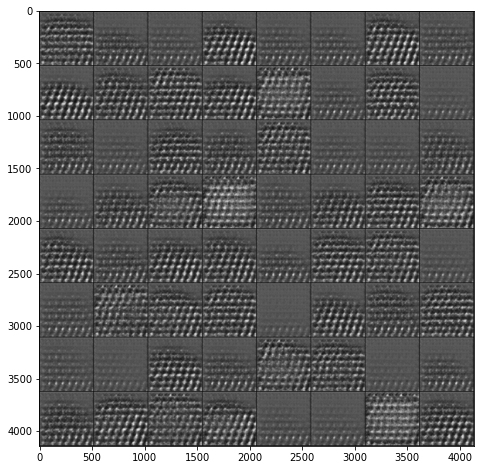

plotted the first generated image


In [ ]:
plt.figure(figsize=(8,8))
plt.imshow((img_list[0].cpu()), cmap='gray', vmin=0, vmax=1)
  # grid was normalized from make_grid so value is 0~1
  # since the images were output of the model on GPU, we have to convert them to host CPU memory for plt to work
plt.savefig(pwd+"/result_figs/first_gen")
plt.show()
print("plotted the first generated image")

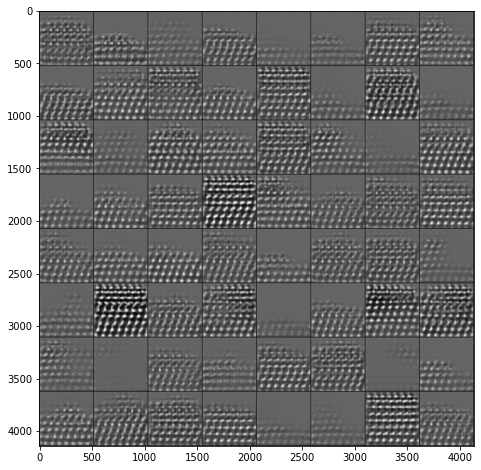

plotted the last generated image


In [ ]:
plt.figure(figsize=(8,8))
plt.imshow((img_list[-1].cpu()), cmap='gray', vmin=0, vmax=1)
  # grid was normalized so value is 0~1
plt.savefig(pwd+"/result_figs/last_gen")
plt.show()
print("plotted the last generated image")

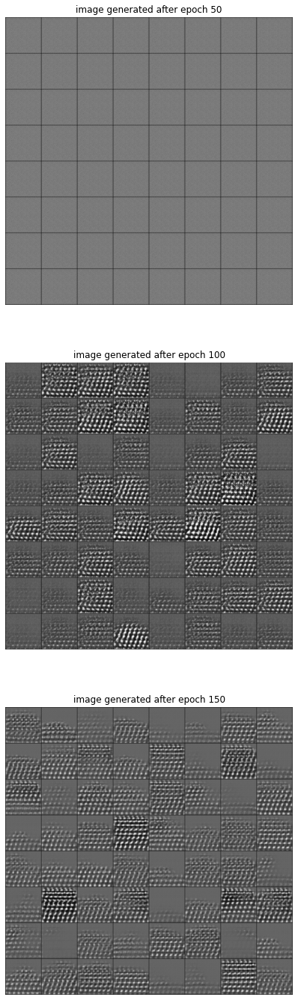

plotted the last imgs generated after every 50 epochs


In [ ]:
plt.figure(figsize=(8,int(8*len(last_imgs))))
  # width 8, height 8*number of images
for i in range(1, len(last_imgs)+1):
  plt.subplot(len(last_imgs), 1, i)
    # add len(last_imgs) rows and 1 column of subplots, this will be the ith of them
  plt.axis("off")
  plt.title("image generated after epoch {}".format(i*num_epochs))
  plt.imshow(last_imgs[i-1], cmap='gray', vmin=0, vmax=1)
plt.savefig(pwd+"/result_figs/last_imgs")
plt.show()
print("plotted the last imgs generated after every {} epochs".format(num_epochs))

## Results

Finally, lets check out how we did. Here, we will look at three different results. First, we will see how `D` and `G`’s losses changed during training. Second, we will visualize `G`’s output on the fixed_noise batch for every epoch. And third, we will look at a batch of real data next to a batch of fake data from `G`.

### Loss versus training iteration

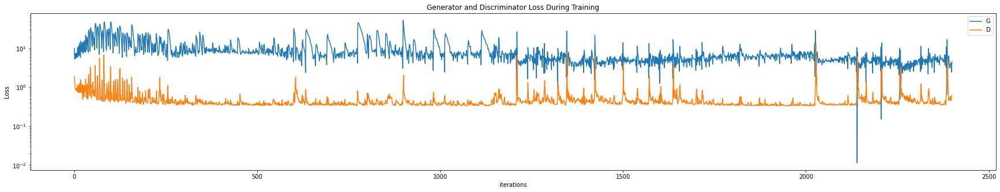

plotted the model losses


In [ ]:
plt.figure(figsize=(int(10*len(last_imgs)),5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.yscale('log')
plt.legend()
plt.savefig(pwd+"/result_figs/GD_loss_plot")
plt.show()
print("plotted the model losses")

### Real Images vs. Fake Images

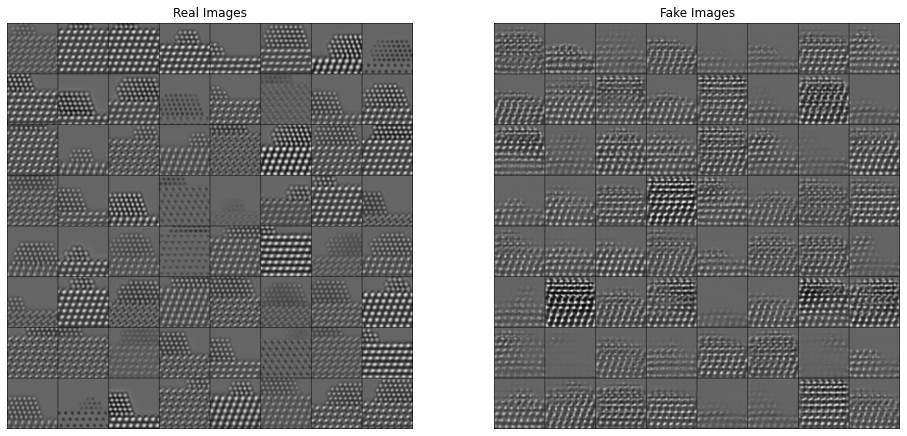

plotted real vs fake image


In [ ]:
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(16,8))
plt.subplot(1,2,1)
  # add 1 row and 2 columns of subplots, this will be the first of them
plt.axis("off")
plt.title("Real Images")
plt.imshow((vutils.make_grid(real_batch[0][:batch_size], nrow=8, padding=5, normalize=True))[0], cmap='gray', vmin=0, vmax=1)

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
  # add 1 row and 2 columns of subplots, this will be the second of them
plt.axis("off")
plt.title("Fake Images")
plt.imshow(img_list[-1], cmap='gray', vmin=0, vmax=1)
plt.savefig(pwd+"/result_figs/real_vs_fake")
plt.show()
print("plotted real vs fake image")

### Visualization of G’s progression

Remember how we saved the generator’s output on the fixed_noise batch after every epoch of training. Now, we can visualize the training progression of `G` with an animation. Press the play button to start the animation.

In [ ]:
# Set up formatting for the movie files
Writer = animation.writers['ffmpeg']
writer = Writer(fps=10, metadata=dict(artist='Me'), bitrate=1800)

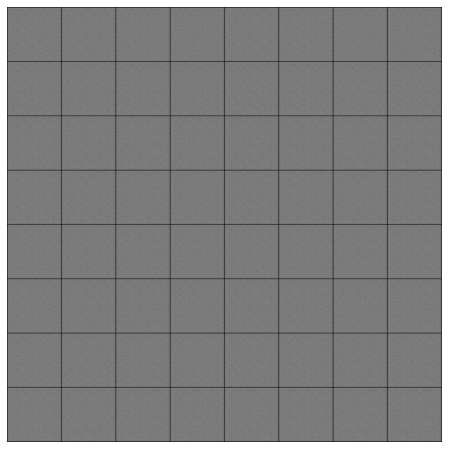

In [ ]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow((i.cpu()), animated=True, cmap='gray')] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
ani.save(pwd+"/result_figs/G_progress.mp4", writer=writer)
  # save the animation to a mp4 video file

HTML(ani.to_jshtml())

# example trial - `0.9` as the real label + no `sigmoid()` + TTUR

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is an real or generated image of shape (nc) x 512 x 512
            nn.Conv2d(nc, ndf, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf) x 256 x 256, where 256 = (n+2p-k)/s+1 = (512+2-4)/2+1 
            nn.Conv2d(ndf, ndf , 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf) x 128 x 128, where 128 = (n+2p-k)/s+1 = (256+2-4)/2+1 
            nn.Conv2d(ndf, ndf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf) x 64 x 64, where 64 = (n+2p-k)/s+1 = (128+2-4)/2+1 
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*2) x 32 x 32, where 32 = (n+2p-k)/s+1 = (64+2-4)/2+1
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*4) x 16 x 16, where 16 = (n+2p-k)/s+1 = (32+2-4)/2+1
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*8) x 8 x 8, where 8 = (n+2p-k)/s+1 = (16+2-4)/2+1  
            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
              # state size. (ndf*16) x 4 x 4, where 4 = (n+2p-k)/s+1 = (8+2-4)/2+1  
            nn.Conv2d(ndf * 16, 1, kernel_size=4, stride=1, padding=0, bias=False),
              # state size. 1 x 1 x 1, where 1 = (n+2p-k)/s+1 = (4+0-4)/1+1 
            # nn.Sigmoid()
              # removed since we are using BCEWithLogitsLoss
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
pwd = "train_BCELogit_0.9_TTUR"

In [ ]:
print("0 if you want to start a fresh training, 1 if you want to continue where you left off")
cont = int(input("continue trianing? "))

0 if you want to start a fresh training, 1 if you want to continue where you left off
continue trianing? 1


In [ ]:
if cont == 1:
  start_epoch = int(input("enter the epoch number from which you'd like to continue training: "))
  print("please make sure that model trained from epoch {} exists".format(start_epoch-1))

enter the epoch number from which you'd like to continue training: 101
please make sure that model trained from epoch 100 exists


In [ ]:
num_epochs= 50

In [ ]:
# reinitialize the models and optimizer
try:
  del netG
  del netD
  del optimizerD
  del optimizerG
  del fixed_noise
  del criterion
  print('deleted')
except:
  print("models don't exist yet")

deleted


In [ ]:
print(pwd)

try:
  os.mkdir(pwd)
  # for storing saved models
except:
  print('directory already exists')

# os.chdir("train_basic")
  # we CANNOT change the current pwd because then the dataloader object cannot queue the data files
  # the dataloader objects queues the data files from the paths we gave it previously, which is no longer visible if we change our pwd
  # just manually add it to all paths below

train_BCELogit_0.9_TTUR
directory already exists


In [ ]:
try:
  os.mkdir(pwd+'/model_checkpoints')
  # for storing saved models
except:
  print('directory already exists')

try:
  os.mkdir(pwd+'/result_figs')
  # for storing figure outputs
except:
  print('directory already exists')

directory already exists
directory already exists


In [ ]:
if cont == 0:
  print("starting fresh training...")
  # Create the generator
  netG = Generator(ngpu).to(device) # moves the model to the GPU
  # Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
  netG.apply(weights_init)
else:
  print("continue training from saved models...")
  path = pwd+"/model_checkpoints/e"+str(start_epoch-1)+"_G"
    # for ex, "model_checkpoints/e400_G"
  netG = torch.load(path).to(device) # moves the model to the GPU
  # the correct generator class (compatible with the model saved) must be defined in order for the saved model to be loaded

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
      # Implements data parallelism at the module level.

# Print the model structure
print(netG)

if cont == 0:
  # Create the Discriminator
  netD = Discriminator(ngpu).to(device)
  # Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
  netD.apply(weights_init)
else:
  path = pwd+"/model_checkpoints/e"+str(start_epoch-1)+"_D"
    # for ex, "model_checkpoints/e400_D"
  netD = torch.load(path).to(device)# moves the model to the GPU
  # the correct discriminator class (compatible with the model saved) must be defined in order for the saved model to be loaded

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Print the model
print(netD)

continue training from saved models...
Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), paddi

In [ ]:
# Initialize BCELoss function
criterion = nn.BCEWithLogitsLoss()
  # This loss combines a Sigmoid layer and the BCELoss in one single class. 
  # This version is more numerically stable than using a plain Sigmoid followed by a BCELoss 
  # as, by combining the operations into one layer,we take advantage of the log-sum-exp trick for numerical stability.
  # learn more here https://github.com/soumith/ganhacks/issues/36
# So we also have to go back to our discriminator to remove the last sigmoid layer

# Create a batch of 64 different latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(batch_size, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 0.9
fake_label = 0.
real_label_G = 1.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=0.0001, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=0.0004, betas=(beta1, 0.999))
  # Two Time-Scale Update Rule
  # a higher learning rate for the discriminator and a lower one for the generator
  # from pt9 in https://towardsdatascience.com/10-lessons-i-learned-training-generative-adversarial-networks-gans-for-a-year-c9071159628

In [ ]:
print(lr)

0.0001


In [ ]:
print("we have {} samples and {} samples per batch, we will have {} batches overall".format(
    len(folder_data), batch_size, len(dataloader)
))
print("there are {} samples in our fixed test set".format(len(fixed_noise)))

we have 1000 samples and 64 samples per batch, we will have 16 batches overall
there are 64 samples in our fixed test set


In [ ]:
# Lists to keep track of progress
if cont == 0:
  logs = dict()
  G_losses = []
  D_losses = []
  start_epoch = 1
  img_list = []
  last_imgs = []
else:
  with open(pwd+"/logs.json", 'r') as fp:
    logs = json.load(fp)
  G_losses = logs["G_losses"]
  D_losses = logs["D_losses"]
  # img_list = torch.load(pwd+"/img_list.ts")
    # this takes too much RAM and stops execution, we will load this in later if needed
  img_list = []
  last_imgs = torch.load(pwd+"/last_imgs.ts")

In [ ]:
iters = 1
checker = 0

print("Starting Training Loop From Epoch {}".format(start_epoch))
# For each epoch
for epoch in range(start_epoch, start_epoch+num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        # i is the batch number
        # data[0] is the list of samples containing batch_size many samples
        # data[1] is the list of corresponding labels but in this case is meaningless, we will create our own labels

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch----------------------------------------------------------------------------
        
        netD.zero_grad() 
          # zero the gradients of model netD, must be done at the start of each batch
        
        # Format batch:
        real_input = data[0].to(device);
          # real image inputs as input to the model 
        
        # if epoch == 1 and i == 0: print(real_input.size())
          
        b_size = real_input.size(0) 
          # number of samples in the current batch
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device) 
          # create a tensor of real labels all as 1 same length as the number of samples in the current batch
          # we can't directly use batch_size here because in the last batch there might be less samples
        
        # Forward pass real batch through D:
        output = netD(real_input).view(-1)
        
        # Calculate loss on all-real batch
        errD_real = criterion(output, label) 
          # computes the loss itself
          # when updating the discriminator, we want to minimize the difference between the D output and 1 for real samples
        
        # Calculate gradients for D in backward pass
        errD_real.backward() 
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netD
        D_x = output.mean().item()
          # compute the mean of the probability predictions for this batch of real images for checking

        ## Train with all-fake batch----------------------------------------------------------------------------
        
        # Generate batch of random latent vectors z, this is randomly generated for every new batch and not fixed
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        
        # Generate a fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label) # create a tensor of fake labels all as 0
        
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
          # computes the loss itself
          # when updating the discriminator, we want to minimize the difference between the D output and 0 for fake samples
        
        # Calculate the gradients for this batch
        errD_fake.backward()
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netD
          # since torch accumulates gradients, and you didn't zero out your gradient after the update above
          # this simply addes the gradient values to the previous gradient values
          # since we want to minimize both fake and real error (w.r.t. to the different label tensors), their sum will also be a goal of us to minimize
        D_G_z1 = output.mean().item()
          # compute the mean of the probability predictions for this batch for checking
        
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
          # this is only for our viewing sake
          # when we called .backward() on both losses the, their gradients were automatically added in the model already
        
        # Update D
        optimizerD.step()
          # update each parameter value in netD according to the gradient values stored for each parameter

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        
        netG.zero_grad()
          # zero the gradients of model netG, must be done at the start of each batch
        label.fill_(real_label_G) 
          # fake images are considered real for the generator cost 
          # because we want the D's output to be close to the classifying them as real
          # remember, the loss is just a measure of how different our prediction is from our result
          # and we update our model to minimize that difference
          # when updating the generator model, we want to minimize the difference between the D output and 1
        
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        
        #Calculate G's loss based on this output
        errG = criterion(output, label)
        
        # Calculate gradients for G
        errG.backward()
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netG
        D_G_z2 = output.mean().item()
          # compute the mean of the probability predictions for this batch for checking
        
        # Update G
        optimizerG.step()
          # update each parameter value in netD according to the gradient values stored for each parameter

        # Output training stats
        if i % 5 == 0 or (i+1) % len(dataloader) == 0: # every 5 batches and the last batch in every epoch
            print('epoch[%d/%d] batch[%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, start_epoch+num_epochs-1, i+1, len(dataloader),errD.item(), errG.item(), D_x, D_G_z1, D_G_z2)
                  )
              # the .item() extract the actual numeric result out of the tensor(~, device='cuda:0') output
            if errD.item() == 0 or errG.item() == 0: # if model enters training failure mode
                checker+=1
            else: # reset checker
                checker=0

            if checker > 50:
                print("training stuck for more than 50 checks, stopping it early")
                break;

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        # for every 50 iterations, and the last batch on the last epoch
        # predict on fixed_noise and generate validation images to get an idea of how well the model is going
        if (iters % 50 == 0) or ((epoch == start_epoch+num_epochs-1) and (i == len(dataloader)-1)):
            print("validating on fixed noise: iteraton %d, epoch %d, batch number %d"% (iters,epoch, i+1))
            
            with torch.no_grad():
            # stops the autograd engine from calculating the gradients, saves time and space
            # which is the recommended way of doing validation
                fake = netG(fixed_noise).detach().cpu()
                  # send it to cpu here because we don't need anything from the gpu to deal with these results
            
            # print(torch.equal(vutils.make_grid(fake, padding=2, normalize=True)[0], vutils.make_grid(fake, padding=2, normalize=True)[1]))
            #   # just re-confirms that all channels of the grid image is the same b/c we are greyscale
            img_list.append(vutils.make_grid(fake, nrow=8, padding=5, normalize=True)[0])
              # make a grid out of the 64 generated images into 1 entire image and add it to list

        iters += 1
    # also save models as checkpoints after each epoch incase training gets interrupted 
    print("model saved on iteration {}, epoch {}, batch {} with G_loss ={}".format(iters-1 ,epoch, i+1, errG.item()))
    torch.save(netG, pwd+'/model_checkpoints/e{}_G'.format(epoch))
    torch.save(netD, pwd+'/model_checkpoints/e{}_D'.format(epoch))
    print(120*'-')
    print() 

last_imgs.append(img_list[-1].cpu())

Starting Training Loop From Epoch 101
epoch[101/150] batch[1/16]	Loss_D: 0.8523	Loss_G: 14.3185	D(x): 8.5121	D(G(z)): -13.0604 / -14.3185
epoch[101/150] batch[6/16]	Loss_D: 0.4711	Loss_G: 7.2324	D(x): 4.5114	D(G(z)): -6.6647 / -7.2309
epoch[101/150] batch[11/16]	Loss_D: 0.3781	Loss_G: 6.4610	D(x): 2.8116	D(G(z)): -5.9452 / -6.4573
epoch[101/150] batch[16/16]	Loss_D: 0.4097	Loss_G: 7.6799	D(x): 3.6812	D(G(z)): -5.3364 / -7.6791
model saved on iteration 16, epoch 101, batch 16 with G_loss =7.679858684539795
------------------------------------------------------------------------------------------------------------------------

epoch[102/150] batch[1/16]	Loss_D: 0.3849	Loss_G: 6.6988	D(x): 1.7316	D(G(z)): -6.3170 / -6.6972
epoch[102/150] batch[6/16]	Loss_D: 0.3492	Loss_G: 5.5810	D(x): 2.2214	D(G(z)): -5.0168 / -5.5763
epoch[102/150] batch[11/16]	Loss_D: 0.4217	Loss_G: 8.0488	D(x): 3.9948	D(G(z)): -7.1127 / -8.0484
epoch[102/150] batch[16/16]	Loss_D: 0.3448	Loss_G: 7.7688	D(x): 2.8082	D(G(

In [ ]:
# save the losses and the validation images so we can re-visit them later
# torch.save(img_list, pwd+"/img_list.ts")
torch.save(img_list, pwd+"/img_list_e{}~{}.ts".format(start_epoch, start_epoch+num_epochs-1))
torch.save(last_imgs, pwd+"/last_imgs.ts")
  # since this list contains tensors, we cannot save with Json
logs["G_losses"] = G_losses
logs["D_losses"] = D_losses
# logs["start_epoch"] = epoch+1
with open(pwd+"/logs.json", 'w') as fp:
    json.dump(logs, fp)

In [ ]:
print("number of grids saved in G's progression: ", len(img_list))

number of grids saved in G's progression:  16


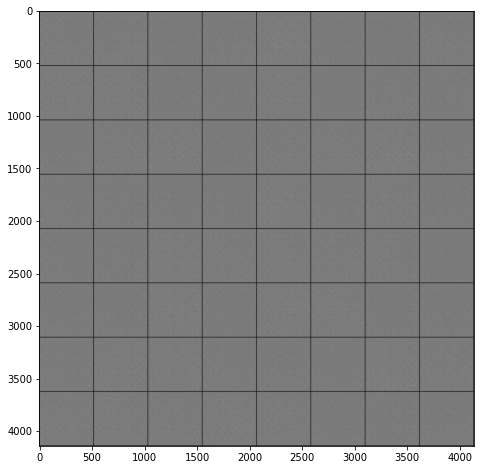

plotted the first generated image


In [ ]:
plt.figure(figsize=(8,8))
plt.imshow((img_list[0].cpu()), cmap='gray', vmin=0, vmax=1)
  # grid was normalized from make_grid so value is 0~1
  # since the images were output of the model on GPU, we have to convert them to host CPU memory for plt to work
plt.savefig(pwd+"/result_figs/first_gen")
plt.show()
print("plotted the first generated image")

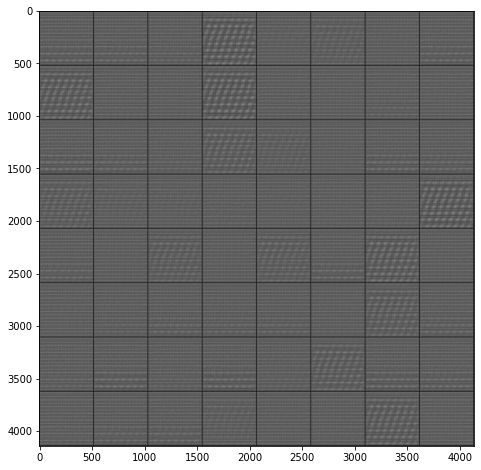

plotted the last generated image


In [ ]:
plt.figure(figsize=(8,8))
plt.imshow((img_list[-1].cpu()), cmap='gray', vmin=0, vmax=1)
  # grid was normalized so value is 0~1
plt.savefig(pwd+"/result_figs/last_gen")
plt.show()
print("plotted the last generated image")

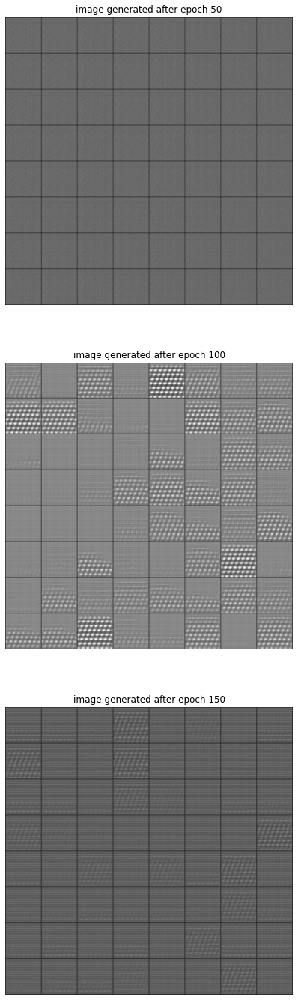

plotted the last imgs generated after every 50 epochs


In [ ]:
plt.figure(figsize=(8,int(8*len(last_imgs))))
  # width 8, height 8*number of images
for i in range(1, len(last_imgs)+1):
  plt.subplot(len(last_imgs), 1, i)
    # add len(last_imgs) rows and 1 column of subplots, this will be the ith of them
  plt.axis("off")
  plt.title("image generated after epoch {}".format(i*num_epochs))
  plt.imshow(last_imgs[i-1], cmap='gray', vmin=0, vmax=1)
plt.savefig(pwd+"/result_figs/last_imgs")
plt.show()
print("plotted the last imgs generated after every {} epochs".format(num_epochs))

## Results

Finally, lets check out how we did. Here, we will look at three different results. First, we will see how `D` and `G`’s losses changed during training. Second, we will visualize `G`’s output on the fixed_noise batch for every epoch. And third, we will look at a batch of real data next to a batch of fake data from `G`.

### Loss versus training iteration

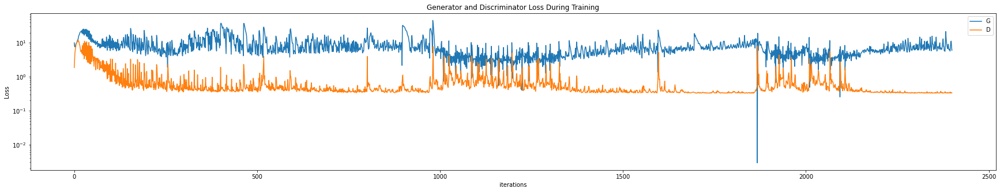

plotted the model losses


In [ ]:
plt.figure(figsize=(int(10*len(last_imgs)),5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.yscale('log')
plt.legend()
plt.savefig(pwd+"/result_figs/GD_loss_plot")
plt.show()
print("plotted the model losses")

### Real Images vs. Fake Images

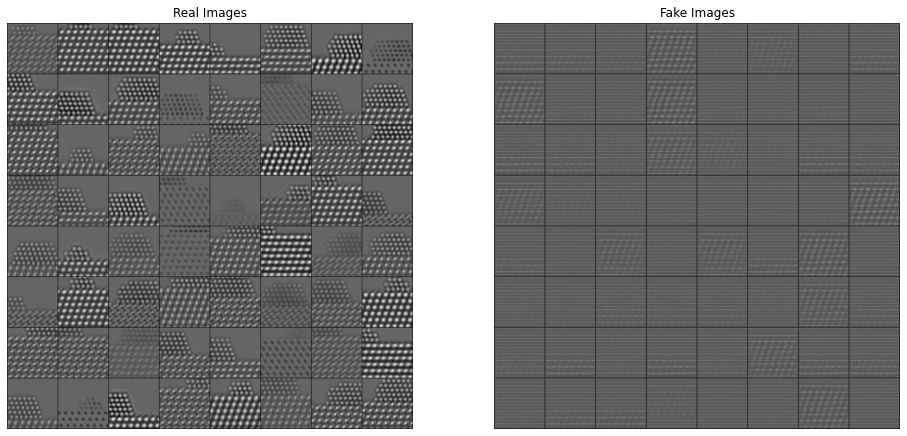

plotted real vs fake image


In [ ]:
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(16,8))
plt.subplot(1,2,1)
  # add 1 row and 2 columns of subplots, this will be the first of them
plt.axis("off")
plt.title("Real Images")
plt.imshow((vutils.make_grid(real_batch[0][:batch_size], nrow=8, padding=5, normalize=True))[0], cmap='gray', vmin=0, vmax=1)

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
  # add 1 row and 2 columns of subplots, this will be the second of them
plt.axis("off")
plt.title("Fake Images")
plt.imshow(img_list[-1], cmap='gray', vmin=0, vmax=1)
plt.savefig(pwd+"/result_figs/real_vs_fake")
plt.show()
print("plotted real vs fake image")

### Visualization of G’s progression

Remember how we saved the generator’s output on the fixed_noise batch after every epoch of training. Now, we can visualize the training progression of `G` with an animation. Press the play button to start the animation.

In [ ]:
# Set up formatting for the movie files
Writer = animation.writers['ffmpeg']
writer = Writer(fps=10, metadata=dict(artist='Me'), bitrate=1800)

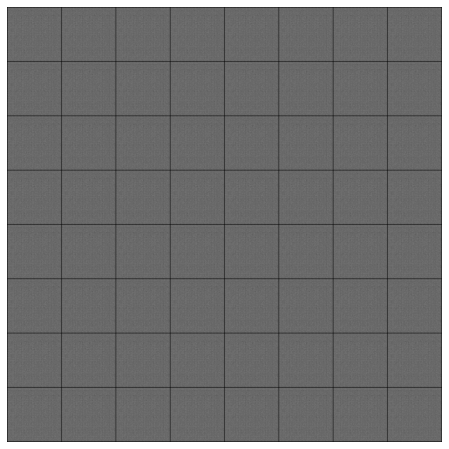

In [ ]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow((i.cpu()), animated=True, cmap='gray')] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
ani.save(pwd+"/result_figs/G_progress_e{}~{}.mp4".format(start_epoch, start_epoch+num_epochs-1), writer=writer)
  # save the animation to a mp4 video file

HTML(ani.to_jshtml())

# possible direction - Wasserstein loss

learn motivation [here](https://developers.google.com/machine-learning/gan/problems)

learn what it is [here](https://developers.google.com/machine-learning/gan/loss)

leanr how to code it [here](https://wiseodd.github.io/techblog/2017/02/04/wasserstein-gan/) which is based on [here](https://wiseodd.github.io/techblog/2017/01/20/gan-pytorch/)

when you need to clip the weights, look for help [here](https://stackoverflow.com/questions/54716377/how-to-do-gradient-clipping-in-pytorch)

# symmetric architecture and  adversarial loss + mse loss

MSE loss would not make sense here though.

In [ ]:
# recreate the models 
try:
  del netG
  del netD
  del optimizerD
  del optimizerG
except:
  print("they don't exist yet")

# Create the generator
netG = Generator(ngpu).to(device)
  # moves the model to the GPU

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
      # Implements data parallelism at the module level.

# Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2.
netG.apply(weights_init)

# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Initialize BCELoss function
criterion = nn.BCELoss()

# Create a batch of 64 different latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
num_epochs=50
wt_mse = 0.05

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        # i is the batch number
        # data[0] is the list of samples containing batch_size many samples
        # data[1] is the list of corresponding labels but in this case is meaningless, we will create our own labels

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch----------------------------------------------------------------------------
        
        netD.zero_grad() 
          # zero the gradients of model netD, must be done at the start of each batch
        
        # Format batch:
        real_input = data[0].to(device) 
        if epoch == 0 and i == 0: print(real_input.size())
          # real image inputs as input to the model
        b_size = real_input.size(0) 
          # batch size
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device) 
          # create a tensor of real labels all as 1 same length as the number of samples in the current batch
        
        # Forward pass real batch through D:
        output = netD(real_input).view(-1)
        
        # Calculate loss on all-real batch
        errD_real = criterion(output, label) 
          # computes the loss itself
          # when updating the discriminator, we want to minimize the difference between the D output and 1 for real samples
        
        # Calculate gradients for D in backward pass
        errD_real.backward() 
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netD
        D_x = output.mean().item()
          # compute the mean of the probability predictions for this batch for checking

        ## Train with all-fake batch----------------------------------------------------------------------------
        
        # Generate batch of random latent vectors z all of length 100 
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label) # create a tensor of fake labels all as 0
        
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
          # computes the loss itself
          # when updating the discriminator, we want to minimize the difference between the D output and 0 for fake samples
        
        # Calculate the gradients for this batch
        errD_fake.backward()
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netD
          # since torch accumulates gradients, and you didn't zero out your gradient after the update above
          # this simply addes the gradient values to the previous gradient values
          # since we want to minimize both fake and real error (w.r.t. to the different label tensors), their sum will also be a goal of us to minimize
        D_G_z1 = output.mean().item()
          # compute the mean of the probability predictions for this batch for checking
        
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
          # this is only for our viewing sake
          # when we called .backward() on both losses the, their gradients were automatically added already
        
        # Update D
        optimizerD.step()
          # update each parameter value in netD according to the gradient values stored for each parameter

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        
        netG.zero_grad()
          # zero the gradients of model netG, must be done at the start of each batch
        label.fill_(real_label) 
          # fake images are considered real for the generator cost 
          # because we want the D's output to be close to the classifying them as real
          # remember, the loss is just a measure of how different our prediction is from our result
          # and we update our model to minimize that difference
          # when updating the generator model, we want to minimize the difference between the D output and 1
        
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        
        #Calculate G's loss based on this output, plus some mse loss between the generated fakes and real images
        errG = (1-wt_mse)*criterion(output, label) + wt_mse*F.mse_loss(fake, real_input)
        
        # Calculate gradients for G
        errG.backward()
          # computes the gradient of the loss w.r.t. all model parameters
          # this step also store the gradients in `parameter.grad` attribute for every parameter in netG
        D_G_z2 = output.mean().item()
          # compute the mean of the probability predictions for this batch for checking
        
        # Update G
        optimizerG.step()
          # update each parameter value in netD according to the gradient values stored for each parameter

        # Output training stats
        if (i+1) % 16 == 0: # for every 16 batches in 1 epoch
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch+1, num_epochs, i+1, len(dataloader),
                      errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        # for every 50 iterations (and the first iteration), and the last batch on the last epoch
        # predict on fixed_noise
        if (iters % 50 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            print(iters,epoch, i)
            with torch.no_grad():
            # stops the autogran engine from calculating the gradients, saves time and space
            # which is the recommended way of doing validation
                fake = netG(fixed_noise).detach().cpu()
            print(torch.equal(vutils.make_grid(fake, padding=2, normalize=True)[0], vutils.make_grid(fake, padding=2, normalize=True)[1]))
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True)[0])
              # make a grid out of the 64 generated images into 1 entire image and add it to list

        iters += 1

Starting Training Loop...
torch.Size([64, 1, 512, 512])
0 0 0
True
[1/50][16/16]	Loss_D: 10.0982	Loss_G: 9.9773	D(x): 0.0588	D(G(z)): 0.0040 / 0.3062
[2/50][16/16]	Loss_D: 9.2401	Loss_G: 9.5264	D(x): 0.3034	D(G(z)): 0.0803 / 0.5381
[3/50][16/16]	Loss_D: 1.7994	Loss_G: 8.6238	D(x): 0.6722	D(G(z)): 0.2771 / 0.1261
50 3 2
True
[4/50][16/16]	Loss_D: 1.8676	Loss_G: 1.2591	D(x): 0.3628	D(G(z)): 0.0050 / 0.3898
[5/50][16/16]	Loss_D: 0.4755	Loss_G: 4.7866	D(x): 0.9662	D(G(z)): 0.2687 / 0.0389
[6/50][16/16]	Loss_D: 2.0105	Loss_G: 5.1991	D(x): 0.4723	D(G(z)): 0.0109 / 0.2499
100 6 4
True
[7/50][16/16]	Loss_D: 5.5480	Loss_G: 8.8900	D(x): 0.1435	D(G(z)): 0.0236 / 0.1089
[8/50][16/16]	Loss_D: 1.8406	Loss_G: 14.0427	D(x): 0.9796	D(G(z)): 0.6145 / 0.0059
[9/50][16/16]	Loss_D: 2.2908	Loss_G: 10.6440	D(x): 0.6572	D(G(z)): 0.0162 / 0.0120
150 9 6
True
[10/50][16/16]	Loss_D: 7.6745	Loss_G: 8.4684	D(x): 0.9239	D(G(z)): 0.6607 / 0.0058
[11/50][16/16]	Loss_D: 2.3187	Loss_G: 11.9412	D(x): 0.8829	D(G(z)): 0.6

In [ ]:
len(img_list)

17

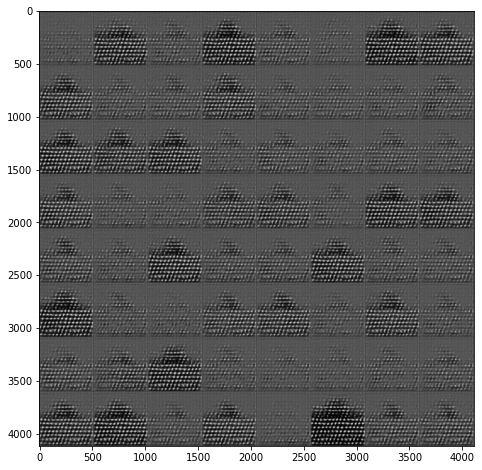

In [ ]:
plt.figure(figsize=(8,8))
plt.imshow((img_list[0]), cmap='gray', vmin=0, vmax=1)
  # grid was normalized so value is 0~1

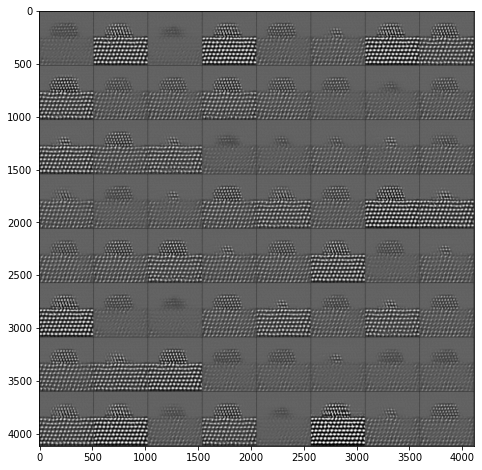

In [ ]:
plt.figure(figsize=(8,8))
plt.imshow((img_list[-1]), cmap='gray', vmin=0, vmax=1)
  # grid was normalized so value is 0~1

## Results

Finally, lets check out how we did. Here, we will look at three different results. First, we will see how `D` and `G`’s losses changed during training. Second, we will visualize `G`’s output on the fixed_noise batch for every epoch. And third, we will look at a batch of real data next to a batch of fake data from `G`.

### Loss versus training iteration

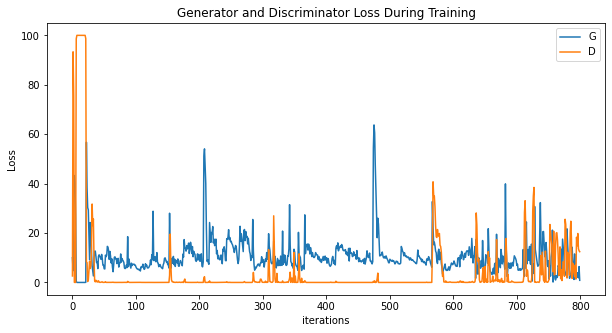

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

### Visualization of G’s progression

Remember how we saved the generator’s output on the fixed_noise batch after every epoch of training. Now, we can visualize the training progression of `G` with an animation. Press the play button to start the animation.

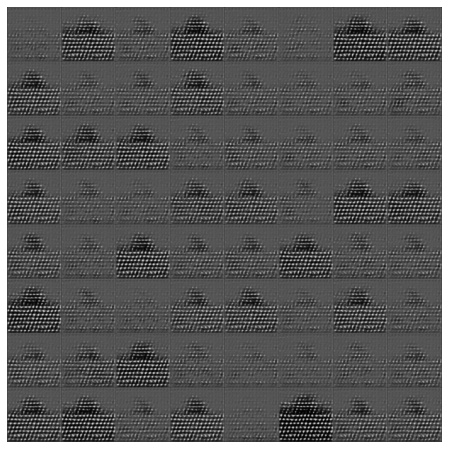

In [ ]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow((i), animated=True, cmap='gray')] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

### Real Images vs. Fake Images

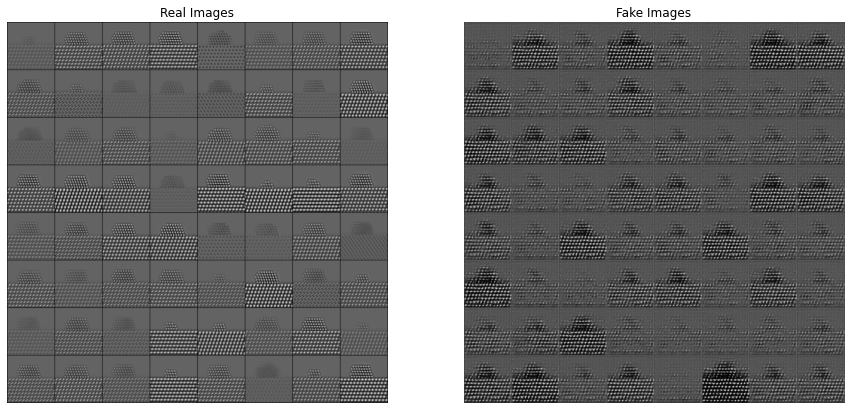

In [ ]:
# Grab a batch (any batch) of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
  # add 1 row and 2 columns of subplots, this will be the first of them
plt.axis("off")
plt.title("Real Images")
plt.imshow((vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu())[0], cmap='gray',
           vmin=0, vmax=1)

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
  # add 1 row and 2 columns of subplots, this will be the second of them
plt.axis("off")
plt.title("Fake Images")
plt.imshow((img_list[-1]), cmap='gray', vmin=0, vmax=1)
plt.show()